#**<center> <h1>DETECCIÓN DE CONTAMINANTES EN EL AGUA</h1> </center>**

<center><img src="https://minas.medellin.unal.edu.co/images/Escudo_color.png" width="300"></center>
<center> <t>Santiago Sosa Garcia, Juan Felipe Saldarriaga, Gabriel Baez Ontiveros<t> </center>


### Introducción

<p style='text-align: justify'>
El agua es un recurso esencial para la vida y el desarrollo de las sociedades, y su calidad es un factor clave en la salud pública y el medio ambiente. En los últimos años, la contaminación del agua se ha convertido en una preocupación global debido al impacto de los desechos industriales, derrames de petróleo y la acumulación de basura en las fuentes naturales de agua. La detección eficiente y automática de contaminantes en cuerpos de agua es un desafío importante que puede contribuir a la mejora en la gestión y tratamiento de recursos hídricos.

Este proyecto tiene como objetivo desarrollar un sistema basado en técnicas de visión artificial para detectar diferentes tipos de contaminantes en el agua utilizando imágenes digitales. Para ello, se emplearán imágenes de distintas fuentes de agua clasificadas en cuatro categorías: agua clara normal, agua de una fuente en sequía, agua contaminada con aceite, auga contaminada con quimicos y agua contaminada con basura. Estas imágenes serán procesadas mediante técnicas de segmentación y clasificación con el fin de identificar y clasificar visualmente los diferentes tipos de contaminantes.

El proyecto aplicará conocimientos adquiridos en procesamiento de imágenes, como la segmentación basada en umbralización y detección de bordes, transformaciones morfológicas para la mejora de la segmentación, y técnicas de clasificación como redes neuronales convolucionales (CNNs). Además, se evaluará la efectividad del sistema utilizando métricas de desempeño como la precisión, exactitud y matriz de confusión.

Este estudio busca sentar las bases para el desarrollo de soluciones automáticas y eficientes que permitan monitorear y detectar contaminantes en fuentes de agua, contribuyendo así a la sostenibilidad ambiental y la protección de los recursos hídricos.

<p>


## Descripción del Dataset

El dataset utilizado en este proyecto proviene de la plataforma [Roboflow Universe](https://universe.roboflow.com/nutchaninphon/water-6vnpp/browse?queryText=&pageSize=50&startingIndex=0&browseQuery=true) y consta de **200 imágenes** en formato JPG con una resolución de **640x640 píxeles**. Las imágenes fueron capturadas en **entornos reales no controlados**, lo que introduce variabilidad en las condiciones de iluminación y composición.

### Composición del Dataset

Las imágenes están distribuidas en las siguientes categorías:

1. **Agua clara normal**: Cuerpos de agua sin contaminantes visibles.
2. **Agua en sequía**: Fuentes de agua con niveles bajos.
3. **Agua contaminada con aceite**: Manchas de aceite visibles en la superficie.
4. **Agua contaminada con basura**: Presencia de desechos sólidos como plásticos.
5. **Agua contaminada con químicos**: Imágenes que presentan sustancias químicas disueltas o visibles en el agua.

### Características Técnicas

- **Formato**: JPG
- **Resolución**: 640x640 píxeles
- **Condiciones**: Entornos no controlados con variabilidad ambiental.

### Tratamiento del Dataset

Para organizar el dataset de manera más eficiente, se desarrolló un [programa en Python](organizarDataset.py) que:

1. **Leía el archivo CSV** donde se encontraban las etiquetas de las imágenes.
2. **Creaba carpetas** para cada clase de agua (agua clara, agua en sequía, agua con aceite, agua con basura, agua con químicos).
3. **Movía y renombraba las imágenes** a su carpeta correspondiente, según su clase.
4. **Actualizaba el CSV** con los nuevos nombres de las imágenes, haciéndolos más entendibles y organizados para el proceso de entrenamiento y prueba.

### Limitaciones

- **Entornos no controlados**: La variabilidad en iluminación y ángulos de toma puede afectar el rendimiento del modelo.
- **Tamaño del dataset**: Si bien 200 imágenes son útiles, podría ser necesario aplicar **aumento de datos** (data augmentation) para mejorar la generalización del modelo.


## Metodología proyecto


### Importacion de librerias

Importamos las librerias necesarias para las diferentes fases del proyecto


In [1]:
# Importar librerías para manejo de datos y visualización
import numpy as np
import pandas as pd
import os
from sklearn.model_selection import train_test_split

# Manejo de imágenes y procesamiento
import cv2  # OpenCV para procesamiento de imágenes
from PIL import Image  # Para manejo de imágenes si es necesario
import matplotlib.pyplot as plt  # Visualización de imágenes y métricas
import seaborn as sns  # Visualización avanzada

# scikit-image para procesamiento avanzado de imágenes
from skimage import io, color, filters, exposure
from skimage.morphology import dilation, erosion, opening, closing
from skimage.filters import threshold_otsu, sobel  # Umbralización y detección de bordes
from skimage.feature import hog, graycomatrix, graycoprops
from skimage.color import rgb2gray


import tensorflow as tf

from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Construcción de modelos (Redes Neuronales Convolucionales - CNN)
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

# Evaluación del modelo
from sklearn.metrics import classification_report, confusion_matrix

### Utilidades

Definimos diferentes funciones utiles para el desarrollo del proyecto


In [2]:
def img_read(filename, mode="color"):
    """
    Lee una imagen y la convierte al espacio de color especificado.

    Parámetros:
    - filename (str): Ruta de la imagen.
    - mode (str): Espacio de color ('RGB', 'GRAY', 'HSV', etc.).

    Retorna:
    - img: Imagen convertida al espacio de color seleccionado o None.
    """
    if mode == "color" or mode == "rgb" or mode == "RGB":
        return cv2.cvtColor(cv2.imread(filename), cv2.COLOR_BGR2RGB)
    elif mode == "grayscale" or mode == "greyscale" or mode == "gray" or mode == "grey":
        return cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    elif mode == "yuv" or mode == "YUV":
        return cv2.cvtColor(cv2.imread(filename), cv2.COLOR_BGR2YUV)
    elif mode == "hsv" or mode == "HSV":
        return cv2.cvtColor(cv2.imread(filename), cv2.COLOR_BGR2HSV)
    elif mode == "lab" or mode == "LAB":
        return cv2.cvtColor(cv2.imread(filename), cv2.COLOR_BGR2LAB)
    elif mode == "lms" or mode == "LMS":
        return cv2.cvtColor(cv2.imread(filename), cv2.COLOR_BGR2LMS)
    elif mode == "xyz" or mode == "XYZ":
        return cv2.cvtColor(cv2.imread(filename), cv2.COLOR_BGR2XYZ)
    elif mode == "hsl" or mode == "HSL":
        return cv2.cvtColor(cv2.imread(filename), cv2.COLOR_BGR2HLS)
    elif mode == "yiq" or mode == "YIQ":
        img = cv2.cvtColor(cv2.imread(filename), cv2.COLOR_BGR2RGB)
        img[:, :, 0] = (
            0.299 * img[:, :, 0] + 0.587 * img[:, :, 1] + 0.114 * img[:, :, 2]
        )
        img[:, :, 1] = (
            0.596 * img[:, :, 0] - 0.274 * img[:, :, 1] - 0.322 * img[:, :, 2]
        )
        img[:, :, 2] = (
            0.211 * img[:, :, 0] - 0.523 * img[:, :, 1] + 0.312 * img[:, :, 2]
        )

        return img
    else:
        return None


def show_image(image, title="Imagen", cmap=None):
    """
    Muestra una imagen usando Matplotlib.

    Parámetros:
    - image: Imagen a mostrar.
    - title (str): Título de la imagen.
    - cmap: Colormap (para imágenes en escala de grises).
    """
    plt.imshow(image, cmap=cmap)
    plt.title(title)
    plt.axis("off")  # Quitar los ejes para mejor visualización
    plt.show()


def show_histogram(image, ax=None, title="Histograma", bins=256, color_space="gray"):
    """
    Muestra el histograma de una imagen en un subplot específico.

    Parámetros:
    - image: Imagen de la que se desea mostrar el histograma.
    - ax: Eje de Matplotlib donde se dibujará el histograma.
    - title (str): Título del histograma.
    - bins (int): Número de bins para el histograma.
    - color_space (str): Espacio de color de la imagen ('gray' o 'rgb'). Si es 'rgb', se muestran histogramas para cada canal.
    """
    if ax is None:
        plt.figure(figsize=(12, 6))

        if color_space == "gray":
            # Si la imagen está en escala de grises, solo un histograma
            plt.hist(image.ravel(), bins=bins, color="gray", alpha=0.7)
            plt.title(title)
            plt.xlabel("Intensidad")
            plt.ylabel("Frecuencia")

        elif color_space == "rgb":
            # Si la imagen está en RGB, mostrar histogramas para cada canal
            colors = ("red", "green", "blue")
            for i, color in enumerate(colors):
                plt.hist(
                    image[:, :, i].ravel(),
                    bins=bins,
                    color=color,
                    alpha=0.7,
                    label=color,
                )
            plt.title(title)
            plt.xlabel("Intensidad")
            plt.ylabel("Frecuencia")
            plt.legend(loc="upper right")

        else:
            raise ValueError(
                f"Espacio de color '{color_space}' no soportado. Usa 'gray' o 'rgb'."
            )

        plt.show()
    else:
        if color_space == "gray":
            # Si la imagen está en escala de grises, solo un histograma
            ax.hist(image.ravel(), bins=bins, color="gray", alpha=0.7)
            ax.set_title(title)
            ax.set_xlabel("Intensidad")
            ax.set_ylabel("Frecuencia")

        elif color_space == "rgb":
            # Si la imagen está en RGB, mostrar histogramas para cada canal
            colors = ("red", "green", "blue")
            for i, color in enumerate(colors):
                ax.hist(
                    image[:, :, i].ravel(),
                    bins=bins,
                    color=color,
                    alpha=0.7,
                    label=color,
                )
            ax.set_title(title)
            ax.set_xlabel("Intensidad")
            ax.set_ylabel("Frecuencia")
            ax.legend(loc="upper right")

        else:
            raise ValueError(
                f"Espacio de color '{color_space}' no soportado. Usa 'gray' o 'rgb'."
            )


def apply_gamma_correction(image, gamma=1.0):
    """
    Aplica corrección gamma a una imagen.

    Parámetros:
    - image: Imagen de entrada (en cualquier espacio de color).
    - gamma (float): Valor de corrección gamma. Los valores menores a 1 oscurecen la imagen,
                     y los valores mayores a 1 la aclaran.

    Retorna:
    - Imagen con corrección gamma aplicada.
    """
    # Normalizar la imagen en el rango [0, 1]
    normalized_img = image / 255.0

    # Aplicar la corrección gamma
    corrected_img = np.power(normalized_img, gamma)

    # Reescalar la imagen al rango [0, 255] y convertir a tipo uint8
    corrected_img = np.uint8(corrected_img * 255)

    return corrected_img


def equalize_histogram(image, color_space="rgb"):
    """
    Ecualiza el histograma de una imagen.

    Parámetros:
    - image: Imagen a la que se desea aplicar la ecualización del histograma.
    - color_space (str): Espacio de color de la imagen ('gray' o 'rgb'). Si es 'rgb', se aplicará ecualización en cada canal.

    Retorna:
    - Imagen con el histograma ecualizado.
    """
    if color_space == "gray":
        # Ecualizar histograma para imagen en escala de grises
        return cv2.equalizeHist(image)

    elif color_space == "rgb":
        # Convertir la imagen RGB a YUV para aplicar ecualización en el canal Y
        img_yuv = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
        img_yuv[:, :, 0] = cv2.equalizeHist(
            img_yuv[:, :, 0]
        )  # Ecualizar solo el canal Y
        return cv2.cvtColor(img_yuv, cv2.COLOR_YUV2RGB)

    else:
        raise ValueError("Espacio de color no soportado. Usa 'gray' o 'rgb'.")


def apply_clahe(image, clip_limit=2.0, tile_grid_size=(8, 8)):
    """
    Aplica la ecualización del histograma con límite de contraste (CLAHE) a una imagen.

    Parámetros:
    - image: Imagen de entrada. Debe estar en escala de grises.
    - clip_limit (float): Límite de contraste para el algoritmo CLAHE. Valores más bajos limitan el contraste más.
    - tile_grid_size (tuple): Tamaño de las regiones en las que se dividirá la imagen antes de aplicar la ecualización local.

    Retorna:
    - Imagen con CLAHE aplicado.
    """
    # Crear un objeto CLAHE con los parámetros especificados
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)

    # Aplicar CLAHE a la imagen
    if len(image.shape) == 2:  # Si la imagen está en escala de grises
        return clahe.apply(image)
    else:
        # Si la imagen está en color, aplicar CLAHE a cada canal de la imagen (generalmente L del espacio LAB)
        lab_image = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)
        l, a, b = cv2.split(lab_image)
        l_clahe = clahe.apply(l)
        lab_clahe = cv2.merge((l_clahe, a, b))
        return cv2.cvtColor(lab_clahe, cv2.COLOR_LAB2RGB)


def apply_gaussian_blur(image, kernel_size=(5, 5)):
    """
    Aplica un desenfoque gaussiano a la imagen.

    Parámetros:
    - image: Imagen a la que se aplicará el desenfoque.
    - kernel_size: Tamaño del kernel para el desenfoque.

    Retorna:
    - Imagen desenfocada.
    """
    return cv2.GaussianBlur(image, kernel_size, 0)


def apply_mean_filter(image, kernel_size=3):
    """
    Aplica el filtro de la media a la imagen.

    Parámetros:
    - image: Imagen a la que se le aplicará el filtro.
    - kernel_size (int): Tamaño del kernel cuadrado. Debe ser un número impar (3, 5, 7, etc.).

    Retorna:
    - Imagen filtrada.
    """
    return cv2.blur(image, (kernel_size, kernel_size))


def apply_local_average_filter(image, kernel_size=3):
    """
    Aplica el filtro de promedio local a la imagen.

    Parámetros:
    - image: Imagen a la que se le aplicará el filtro.
    - kernel_size (int): Tamaño del kernel cuadrado. Debe ser un número impar (3, 5, 7, etc.).

    Retorna:
    - Imagen filtrada.
    """
    return cv2.boxFilter(
        image, ddepth=-1, ksize=(kernel_size, kernel_size), normalize=True
    )


def apply_fourier_transform(image):
    """
    Aplica la Transformada de Fourier a la imagen y retorna la magnitud de la imagen transformada.

    Parámetros:
    - image: Imagen a la que se aplicará la Transformada de Fourier.

    Retorna:
    - Magnitud de la Transformada de Fourier.
    """
    f_transform = np.fft.fft2(image)
    f_transform_shifted = np.fft.fftshift(f_transform)
    magnitude_spectrum = 20 * np.log(np.abs(f_transform_shifted) + 1)
    return magnitude_spectrum


def threshold_segmentation(image, threshold_value=127):
    """
    Segmenta la imagen usando un umbral fijo.

    Parámetros:
    - image: Imagen en escala de grises para segmentación.
    - threshold_value: Valor del umbral para segmentar la imagen.

    Retorna:
    - Imagen segmentada.
    """
    _, segmented_image = cv2.threshold(image, threshold_value, 255, cv2.THRESH_BINARY)
    return segmented_image


def edge_detection(image, method="canny"):
    """
    Detecta bordes en la imagen usando el método especificado.

    Parámetros:
    - image: Imagen en escala de grises para detección de bordes.
    - method: Método de detección de bordes ('canny' o 'sobel').

    Retorna:
    - Imagen con bordes detectados.
    """
    if method == "canny":
        edges = cv2.Canny(image, 100, 200)
    elif method == "sobel":
        sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
        sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
        edges = cv2.magnitude(sobel_x, sobel_y)
    return edges


def watershed_segmentation(img, line_thickness=3):
    """
    Aplica la segmentación watershed a una imagen RGB y dibuja los bordes.

    Parámetros:
    - image: Imagen en color (RGB).
    - line_thickness (int): Grosor de la línea de los bordes.

    Retorna:
    - Imagen segmentada con bordes más gruesos.
    """
    image = img.copy()
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    ret, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

    # Remover ruido
    kernel = np.ones((3, 3), np.uint8)
    opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=2)

    # Encontrar el área de fondo
    sure_bg = cv2.dilate(opening, kernel, iterations=3)

    # Encontrar el área de primer plano
    dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
    ret, sure_fg = cv2.threshold(dist_transform, 0.7 * dist_transform.max(), 255, 0)

    # Marcar los objetos desconocidos
    sure_fg = np.uint8(sure_fg)
    unknown = cv2.subtract(sure_bg, sure_fg)

    # Etiquetas de marcadores
    ret, markers = cv2.connectedComponents(sure_fg)

    # Añadir 1 a las etiquetas para que el fondo sea 1 en lugar de 0
    markers = markers + 1

    # Marcar los píxeles desconocidos como 0
    markers[unknown == 255] = 0

    markers = cv2.watershed(image, markers)

    # Crear máscara de los bordes (marcados con -1) y hacerlos más gruesos
    borders = (markers == -1).astype(np.uint8)  # Convertir bordes a binario
    borders = cv2.dilate(
        borders,
        kernel=np.ones((line_thickness, line_thickness), np.uint8),
        iterations=1,
    )  # Engrosar bordes

    # Dibujar los bordes en la imagen original en rojo
    image[borders == 1] = [255, 0, 0]  # Color rojo

    return image


def grabcut_segmentation(image, iter_count=5):
    """
    Aplica la segmentación GrabCut a una imagen RGB.

    Parámetros:
    - image: Imagen en color (RGB).
    - iter_count: Número de iteraciones para el algoritmo GrabCut.

    Retorna:
    - Imagen segmentada.
    """
    mask = np.zeros(image.shape[:2], np.uint8)

    bgd_model = np.zeros((1, 65), np.float64)
    fgd_model = np.zeros((1, 65), np.float64)

    rect = (50, 50, image.shape[1] - 50, image.shape[0] - 50)

    cv2.grabCut(
        image, mask, rect, bgd_model, fgd_model, iter_count, cv2.GC_INIT_WITH_RECT
    )

    mask2 = np.where((mask == 2) | (mask == 0), 0, 1).astype("uint8")
    img_seg = image * mask2[:, :, np.newaxis]

    return img_seg


def kmeans_segmentation(image, k=2, attempts=10):
    """
    Aplica la segmentación K-means a una imagen RGB.

    Parámetros:
    - image: Imagen en color (RGB).
    - k: Número de clusters (clases).
    - attempts: Número de veces que se ejecutará el algoritmo K-means.

    Retorna:
    - Imagen segmentada.
    """
    Z = image.reshape((-1, 3))
    Z = np.float32(Z)

    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.2)
    ret, label, center = cv2.kmeans(
        Z, k, None, criteria, attempts, cv2.KMEANS_RANDOM_CENTERS
    )

    center = np.uint8(center)
    res = center[label.flatten()]
    segmented_image = res.reshape((image.shape))

    return segmented_image


def morphological_operations(image, operation="erosion", kernel_size=(5, 5)):
    """
    Aplica una operación morfológica a la imagen.

    Parámetros:
    - image: Imagen a la que se aplicará la operación.
    - operation: Tipo de operación morfológica ('erosion', 'dilation', etc.).
    - kernel_size: Tamaño del elemento estructurante.

    Retorna:
    - Imagen después de la operación morfológica.
    """
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, kernel_size)
    if operation == "erosion":
        result = cv2.erode(image, kernel, iterations=1)
    elif operation == "dilation":
        result = cv2.dilate(image, kernel, iterations=1)
    return result


def extract_hog_features(image):
    """
    Extrae características HOG de la imagen.

    Parámetros:
    - image: Imagen en escala de grises o en color (se convierte a escala de grises).

    Retorna:
    - hog_features: Un vector con las características HOG extraídas.
    """
    # Asegurarse de que la imagen esté en escala de grises
    if len(image.shape) == 3:
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    else:
        gray_image = image

    # Extraer características HOG
    hog_features, hog_image = hog(
        gray_image,
        orientations=9,
        pixels_per_cell=(8, 8),
        cells_per_block=(2, 2),
        block_norm="L2-Hys",
        visualize=True,
    )

    return hog_features, hog_image


def analyze_texture(image, distances=[1], angles=[0]):
    """
    Analiza la textura de una imagen usando la matriz de co-ocurrencia de nivel de gris (GLCM).

    Parámetros:
    - image: Imagen en formato RGB.
    - distances: Distancias de píxeles para GLCM.
    - angles: Ángulos de dirección para GLCM.

    Retorna:
    - texture_features: Diccionario con características de textura (contraste, homogeneidad, etc.).
    """
    # Convertir imagen a escala de grises
    gray_image = rgb2gray(image)

    # Calcular la matriz de co-ocurrencia (GLCM)
    glcm = graycomatrix(
        np.uint8(gray_image * 255),
        distances=distances,
        angles=angles,
        levels=256,
        symmetric=True,
        normed=True,
    )

    # Extraer propiedades de textura de GLCM
    contrast = graycoprops(glcm, "contrast")
    homogeneity = graycoprops(glcm, "homogeneity")
    energy = graycoprops(glcm, "energy")
    correlation = graycoprops(glcm, "correlation")

    texture_features = {
        "Contraste": contrast.mean(),
        "Homogeneidad": homogeneity.mean(),
        "Energía": energy.mean(),
        "Correlación": correlation.mean(),
    }

    return texture_features

### Constantes

Definimos contantes del proyecto


In [5]:
# from google.colab import drive
# drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import os

# Ruta a la carpeta en Google Drive
base_dir = "imageWater"

# Listar archivos en la carpeta
print("Archivos en la carpeta 'Imagenes':", os.listdir(base_dir))

Archivos en la carpeta 'Imagenes': ['README.dataset.txt', 'README.roboflow.txt', 'test', 'test_classes.csv', 'train', 'train_classes.csv']


In [12]:
# Clases de Agua
CLASSES = {
    " normal-water": "Agua Clara Normal",
    " dry-water": "Agua de Fuente en Sequía",
    " oil-contaminated-water": "Agua Contaminada con Aceite",
    " polluted-water": "Agua Contaminada con Basura",
    " chemical-water": "Agua Contaminada por Químicos",
}

# Rutas de Datos
RUTA_TRAIN = os.path.join("imageWater/train")
RUTA_TEST = os.path.join("imageWater/test")

RUTA_LIMPIA_TRAIN = os.path.join("imageWater/train/normal-water")
RUTA_SEQUIA_TRAIN = os.path.join("imageWater/train/dry-water")
RUTA_ACEITE_TRAIN = os.path.join("imageWater/train/oil-contaminated-water")
RUTA_BASURA_TRAIN = os.path.join("imageWater/train/polluted-water")
RUTA_QUIMICOS_TRAIN = os.path.join("imageWater/train/chemical-water")

RUTA_LIMPIA_TEST = os.path.join("imageWater/test/normal-water")
RUTA_SEQUIA_TEST = os.path.join("imageWater/test/dry-water")
RUTA_ACEITE_TEST = os.path.join("imageWater/test/oil-contaminated-water")
RUTA_BASURA_TEST = os.path.join("imageWater/test/polluted-water")
RUTA_QUIMICOS_TEST = os.path.join("imageWater/test/chemical-water")

RUTA_LABELS_TRAIN = "imageWater/train_classes.csv"
RUTA_LABELS_TEST = "imageWater/test_classes.csv"

# Nombres imagenes
NOMBRES_LIMPIA_TRAIN = sorted(os.listdir(RUTA_LIMPIA_TRAIN))
NOMBRES_SEQUIA_TRAIN = sorted(os.listdir(RUTA_SEQUIA_TRAIN))
NOMBRES_ACEITE_TRAIN = sorted(os.listdir(RUTA_ACEITE_TRAIN))
NOMBRES_BASURA_TRAIN = sorted(os.listdir(RUTA_BASURA_TRAIN))
NOMBRES_QUIMICOS_TRAIN = sorted(os.listdir(RUTA_QUIMICOS_TRAIN))

NOMBRES_LIMPIA_TEST = sorted(os.listdir(RUTA_LIMPIA_TEST))
NOMBRES_SEQUIA_TEST = sorted(os.listdir(RUTA_SEQUIA_TEST))
NOMBRES_ACEITE_TEST = sorted(os.listdir(RUTA_ACEITE_TEST))
NOMBRES_BASURA_TEST = sorted(os.listdir(RUTA_BASURA_TEST))
NOMBRES_QUIMICOS_TEST = sorted(os.listdir(RUTA_QUIMICOS_TEST))

# Parámetros de Preprocesamiento
IMAGE_WIDTH = 640
IMAGE_HEIGHT = 640

Ruta de la imagen: imageWater/test/normal-water\test_imagen_1_ normal-water.jpg


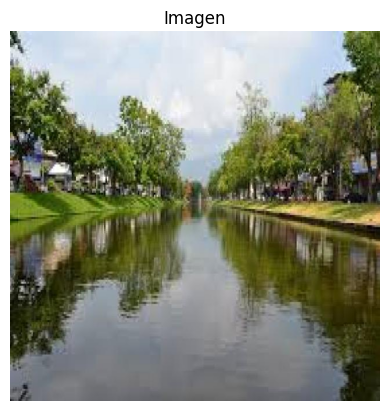

Dimensiones de la imagen: (640, 640, 3)


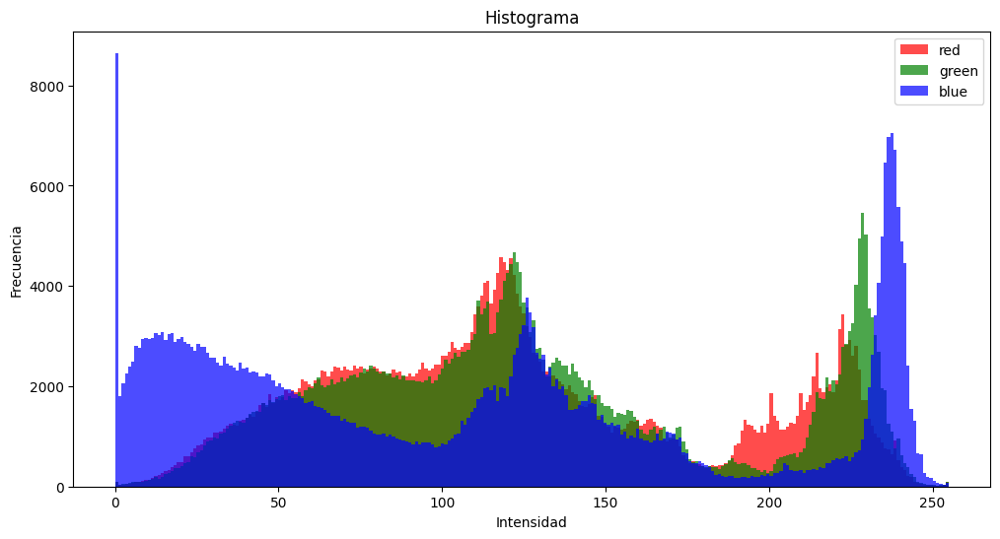

In [13]:
# ejemplo de imagen
image = os.path.join(RUTA_LIMPIA_TEST, NOMBRES_LIMPIA_TEST[0])
print(f"Ruta de la imagen: {image}")

# Leer imagen
image = img_read(image)
show_image(image)

# Mostrar dimensiones de la imagen
print(f"Dimensiones de la imagen: {image.shape}")

# Mostrar histograma de la imagen

show_histogram(image, color_space="rgb")

### Analisis exploratorio

Para el proyecto, realizaremos un análisis exploratorio inicial de las imágenes con el fin de obtener una visión general del dataset. Este proceso nos ayudará a identificar patrones visuales, diferencias entre las clases de agua y cualquier anomalía que pueda estar presente en las imágenes


Veamos los nombres de las imagenes de cada unas de las clases


In [9]:
# nombres de agua limpia
print(NOMBRES_LIMPIA_TRAIN[:5])
print(NOMBRES_LIMPIA_TEST[:5])

# nombres de agua de fuente en sequía
print(NOMBRES_SEQUIA_TRAIN[:5])
print(NOMBRES_SEQUIA_TEST[:5])

# nombres de agua contaminada con aceite
print(NOMBRES_ACEITE_TRAIN[:5])
print(NOMBRES_ACEITE_TEST[:5])

# nombres de agua contaminada con basura
print(NOMBRES_BASURA_TRAIN[:5])
print(NOMBRES_BASURA_TEST[:5])

# nombres de agua contaminada por químicos
print(NOMBRES_QUIMICOS_TRAIN[:5])
print(NOMBRES_QUIMICOS_TEST[:5])

['train_imagen_10_ normal-water.jpg', 'train_imagen_11_ normal-water.jpg', 'train_imagen_12_ normal-water.jpg', 'train_imagen_13_ normal-water.jpg', 'train_imagen_14_ normal-water.jpg']
['test_imagen_1_ normal-water.jpg', 'test_imagen_2_ normal-water.jpg']
['train_imagen_10_ dry-water.jpg', 'train_imagen_11_ dry-water.jpg', 'train_imagen_12_ dry-water.jpg', 'train_imagen_13_ dry-water.jpg', 'train_imagen_14_ dry-water.jpg']
['test_imagen_1_ dry-water.jpg', 'test_imagen_2_ dry-water.jpg', 'test_imagen_3_ dry-water.jpg', 'test_imagen_4_ dry-water.jpg']
['train_imagen_10_ oil-contaminated-water.jpg', 'train_imagen_11_ oil-contaminated-water.jpg', 'train_imagen_12_ oil-contaminated-water.jpg', 'train_imagen_13_ oil-contaminated-water.jpg', 'train_imagen_14_ oil-contaminated-water.jpg']
['test_imagen_1_ oil-contaminated-water.jpg', 'test_imagen_2_ oil-contaminated-water.jpg', 'test_imagen_3_ oil-contaminated-water.jpg']
['train_imagen_10_ polluted-water.jpg', 'train_imagen_11_ polluted-wate

Cantidad de imagenes


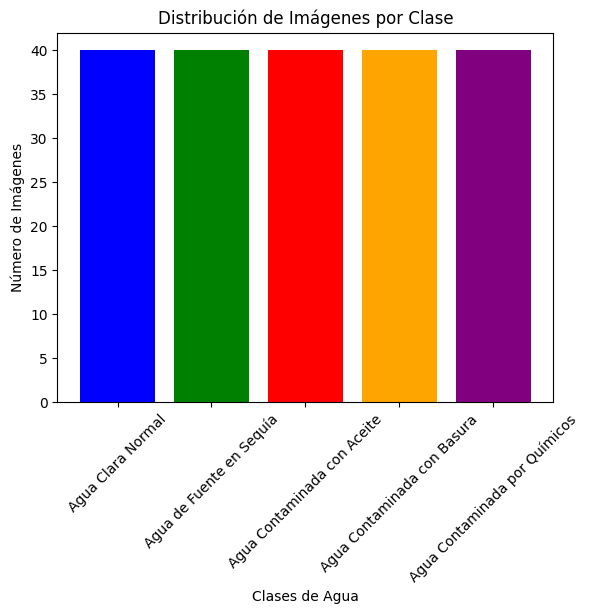

Imagenes entrenamiento limpia: 38
Imagenes prueba limpia: 2
Imagenes entrenamiento sequia: 36
Imagenes prueba sequia: 4
Imagenes entrenamiento aceite: 37
Imagenes prueba aceite: 3
Imagenes entrenamiento basura: 35
Imagenes prueba basura: 5
Total de Imágenes: 200


In [10]:
def contar_imagenes_por_clase():
    """
    Cuenta cuántas imágenes hay en cada clase de agua.

    Retorna:
    - Un diccionario con el número de imágenes por clase.
    """
    # Diccionario para almacenar el conteo
    conteo_imagenes = {
        "Agua Clara Normal": len(NOMBRES_LIMPIA_TRAIN) + len(NOMBRES_LIMPIA_TEST),
        "Agua de Fuente en Sequía": len(NOMBRES_SEQUIA_TRAIN)
        + len(NOMBRES_SEQUIA_TEST),
        "Agua Contaminada con Aceite": len(NOMBRES_ACEITE_TRAIN)
        + len(NOMBRES_ACEITE_TEST),
        "Agua Contaminada con Basura": len(NOMBRES_BASURA_TRAIN)
        + len(NOMBRES_BASURA_TEST),
        "Agua Contaminada por Químicos": len(NOMBRES_QUIMICOS_TRAIN)
        + len(NOMBRES_QUIMICOS_TEST),
    }

    return conteo_imagenes


# Contar las imágenes y mostrar los resultados
conteo = contar_imagenes_por_clase()
plt.bar(
    conteo.keys(), conteo.values(), color=["blue", "green", "red", "orange", "purple"]
)
plt.xlabel("Clases de Agua")
plt.ylabel("Número de Imágenes")
plt.title("Distribución de Imágenes por Clase")
plt.xticks(rotation=45)
plt.show()

# Numero total de imagenes
# Imprimir la cantidad de imagenes
print("Imagenes entrenamiento limpia:", len(NOMBRES_LIMPIA_TRAIN))
print("Imagenes prueba limpia:", len(NOMBRES_LIMPIA_TEST))

print("Imagenes entrenamiento sequia:", len(NOMBRES_SEQUIA_TRAIN))
print("Imagenes prueba sequia:", len(NOMBRES_SEQUIA_TEST))

print("Imagenes entrenamiento aceite:", len(NOMBRES_ACEITE_TRAIN))
print("Imagenes prueba aceite:", len(NOMBRES_ACEITE_TEST))

print("Imagenes entrenamiento basura:", len(NOMBRES_BASURA_TRAIN))
print("Imagenes prueba basura:", len(NOMBRES_BASURA_TEST))

totalImagenes = sum(list(conteo.values()))
print(f"Total de Imágenes: {totalImagenes}")

- podemos observar que el dataset tiene sus clases balanceadas


##### Ejemplos de diferentes imagenes de cada clase


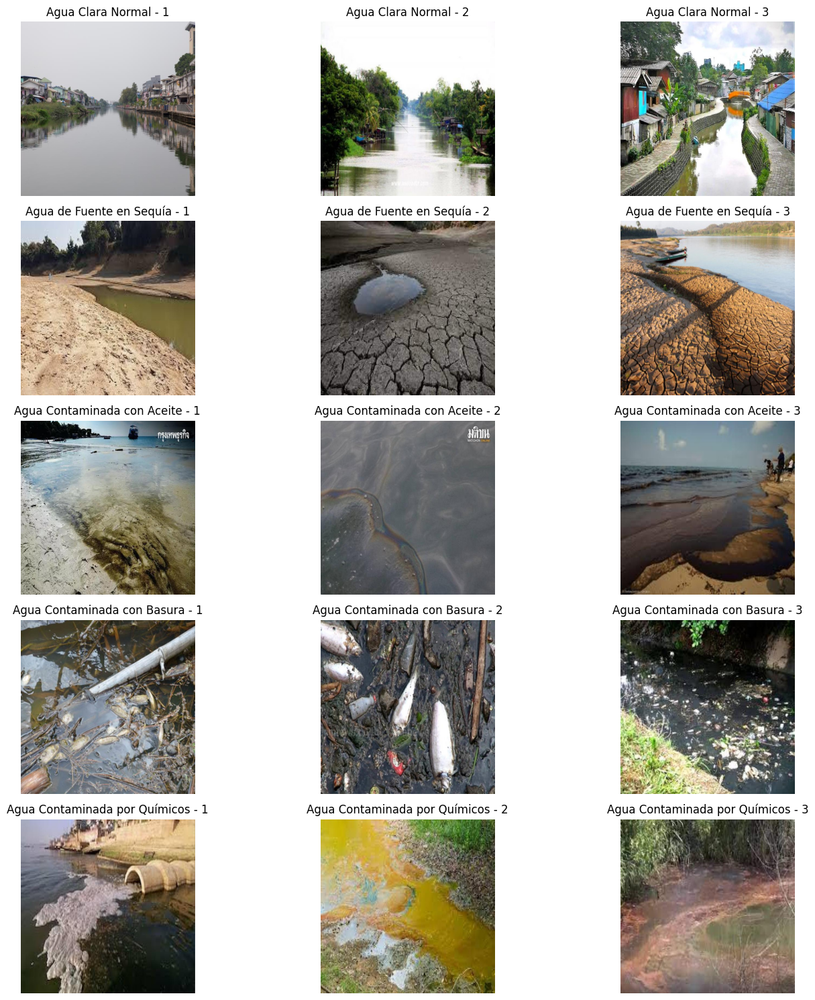

In [11]:
# Mostrar ejemplos de imágenes por clase

muestras = 3
# Diccionario de rutas y nombres de imágenes por clase
rutas_train = {
    "Agua Clara Normal": (RUTA_LIMPIA_TRAIN, NOMBRES_LIMPIA_TRAIN),
    "Agua de Fuente en Sequía": (RUTA_SEQUIA_TRAIN, NOMBRES_SEQUIA_TRAIN),
    "Agua Contaminada con Aceite": (RUTA_ACEITE_TRAIN, NOMBRES_ACEITE_TRAIN),
    "Agua Contaminada con Basura": (RUTA_BASURA_TRAIN, NOMBRES_BASURA_TRAIN),
    "Agua Contaminada por Químicos": (RUTA_QUIMICOS_TRAIN, NOMBRES_QUIMICOS_TRAIN),
}

clases = list(rutas_train.keys())  # Lista de nombres de clases
fig, axes = plt.subplots(
    len(clases), muestras, figsize=(15, 15)
)  # Crear la figura con subplots

# Recorrer cada clase y cargar las imágenes
for idx, (clase, (ruta, nombres)) in enumerate(rutas_train.items()):
    for i in range(muestras):
        if i < len(nombres):  # Asegurarse de no salir del índice de nombres
            img_path = os.path.join(ruta, nombres[i])
            img = img_read(
                img_path, mode="color"
            )  # Cargar imagen con tu función personalizada
            axes[idx, i].imshow(img)  # Mostrar imagen en la rejilla
            axes[idx, i].set_title(f"{clase} - {i+1}")  # Título de cada imagen
            axes[idx, i].axis("off")  # Quitar los ejes
        else:
            axes[idx, i].axis("off")  # Si no hay más imágenes, ocultar subplots vacíos

plt.tight_layout()  # Asegurar que no haya solapamiento de títulos
plt.show()

##### Ejemplos de sus histogramas de imagen de cada clase


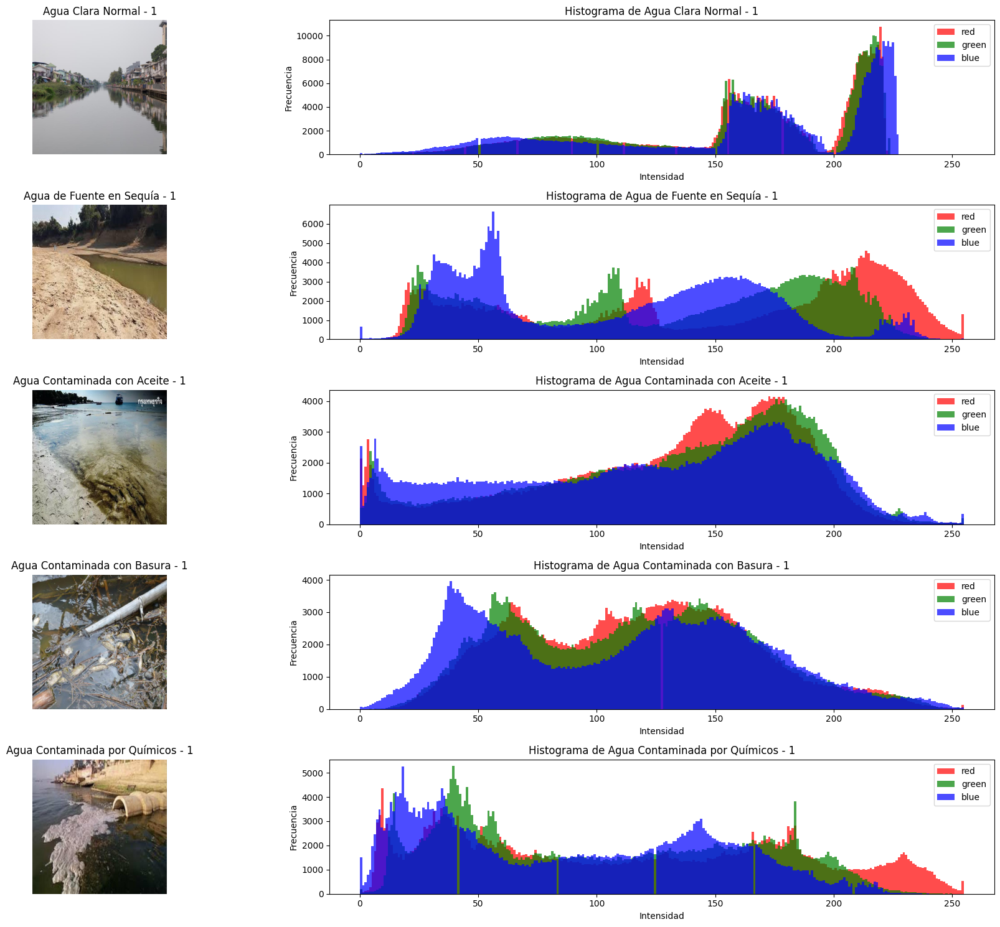

In [12]:
def mostrar_imagenes_y_histogramas(muestras=3):
    """
    Muestra una cantidad específica de imágenes de ejemplo por clase junto con sus histogramas.

    Parámetros:
    - muestras: Número de imágenes a mostrar por clase.
    """
    rutas_train = {
        "Agua Clara Normal": (RUTA_LIMPIA_TRAIN, NOMBRES_LIMPIA_TRAIN),
        "Agua de Fuente en Sequía": (RUTA_SEQUIA_TRAIN, NOMBRES_SEQUIA_TRAIN),
        "Agua Contaminada con Aceite": (RUTA_ACEITE_TRAIN, NOMBRES_ACEITE_TRAIN),
        "Agua Contaminada con Basura": (RUTA_BASURA_TRAIN, NOMBRES_BASURA_TRAIN),
        "Agua Contaminada por Químicos": (RUTA_QUIMICOS_TRAIN, NOMBRES_QUIMICOS_TRAIN),
    }

    clases = list(rutas_train.keys())
    fig, axes = plt.subplots(
        len(clases), 2 * muestras, figsize=(20, 15)
    )  # Crear la figura

    # Recorrer cada clase y cargar las imágenes
    for idx, (clase, (ruta, nombres)) in enumerate(rutas_train.items()):
        for i in range(muestras):
            if i < len(nombres):
                img_path = os.path.join(ruta, nombres[i])
                img = img_read(img_path, mode="color")  # Cargar imagen con tu función

                # Mostrar la imagen en el subplot
                axes[idx, 2 * i].imshow(img)
                axes[idx, 2 * i].set_title(f"{clase} - {i+1}")
                axes[idx, 2 * i].axis("off")

                # Mostrar el histograma en el subplot adyacente
                show_histogram(
                    img,
                    ax=axes[idx, 2 * i + 1],
                    title=f"Histograma de {clase} - {i+1}",
                    color_space="rgb",
                )
            else:
                # Si no hay más imágenes, ocultar los subplots vacíos
                axes[idx, 2 * i].axis("off")
                axes[idx, 2 * i + 1].axis("off")

    plt.tight_layout()
    plt.show()


mostrar_imagenes_y_histogramas(1)

- Se puede observar cómo son imágenes bien iluminadas, lo que se refleja en un histograma con buena uniformidad en la distribución de intensidades. Esto indica que no hay grandes áreas sobreexpuestas o subexpuestas, y los valores de los píxeles están distribuidos de manera equilibrada a lo largo del espectro de intensidades.


Veamos mas ejemplos de mas imagenes con sus histogramas


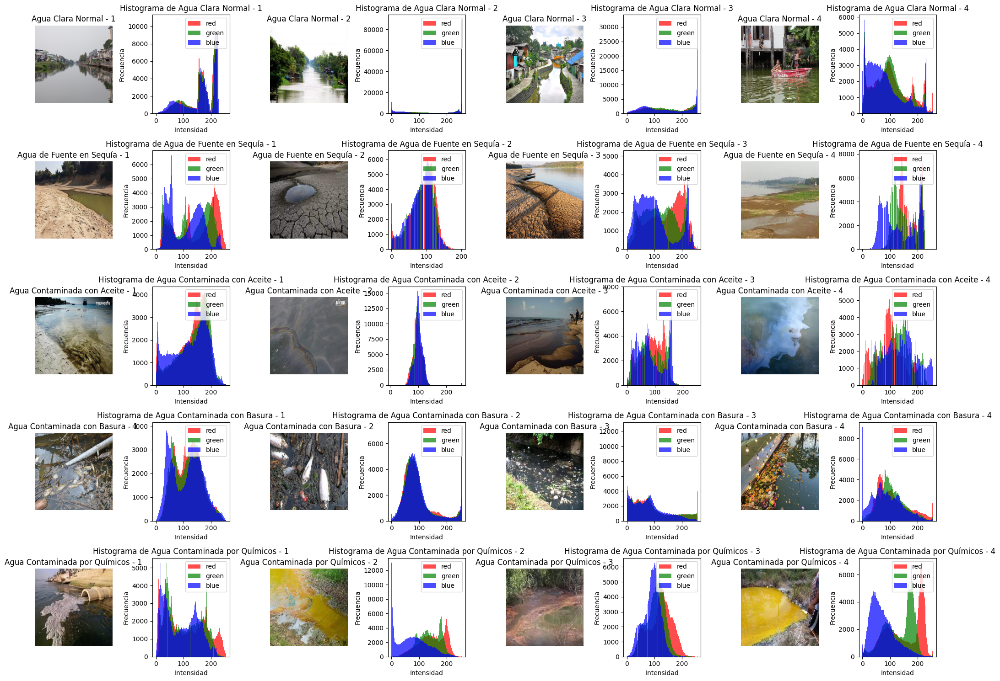

In [13]:
mostrar_imagenes_y_histogramas(4)

- Notamos que las imágenes del dataset, al hacer un análisis visual preliminar, presentan histogramas medianamente parecidos entre las imágenes de la misma clase. Esto sugiere que existe una coherencia en la distribución de las intensidades dentro de cada categoría, lo cual podría facilitar la diferenciación entre clases. Sin embargo, para mejorar aún más la discriminación entre las clases, podemos aplicar transformaciones y técnicas de preprocesamiento adicionales para acentuar las características particulares de cada tipo de imagen, maximizando así su capacidad de clasificación en etapas posteriores.


### Preprocesamiento de imagenes


#### Analicemos diferentes espacios de color

Los diferentes espacios de colores nos permiten observar cómo la información se distribuye en cada canal, lo cual es clave para identificar las características específicas que queremos extraer, facilitando la detección de patrones, bordes o áreas de interés. Esta diferenciación entre canales ayuda a mejorar la segmentación y el procesamiento posterior, permitiendo que ciertas clases de contaminantes o características sobresalgan según el canal y el espacio de color utilizado.


In [14]:
def mostrar_canales_espacios_de_color(filename):
    # Definir los espacios de color a visualizar
    espacios_de_color = ["RGB", "HSV", "YUV", "LAB", "XYZ", "YIQ", "HSL"]
    canales_por_espacio = {
        "RGB": ["R", "G", "B"],
        "HSV": ["H", "S", "V"],
        "YUV": ["Y", "U", "V"],
        "LAB": ["L", "A", "B"],
        "XYZ": ["X", "Y", "Z"],
        "YIQ": ["Y", "I", "Q"],
        "HSL": ["H", "S", "L"],
    }

    # Crear la figura con el número de filas igual a los espacios de color
    fig, axes = plt.subplots(len(espacios_de_color), 3, figsize=(10, 20))
    fig.suptitle("Canales en diferentes espacios de color", fontsize=16)

    for i, espacio in enumerate(espacios_de_color):
        # Leer la imagen en el espacio de color actual
        img = img_read(filename, mode=espacio)

        # Separar los canales de la imagen
        if img is not None and len(img.shape) == 3:
            for j in range(3):
                canal = img[:, :, j]

                # Mostrar cada canal en su correspondiente subfigura
                axes[i, j].imshow(canal, cmap="gray")
                axes[i, j].set_title(f"{espacio} - {canales_por_espacio[espacio][j]}")
                axes[i, j].axis("off")
        else:
            print(f"Error al cargar la imagen en el espacio de color {espacio}.")

    # Ajustar el espaciado de la figura para evitar solapamientos
    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    plt.show()

Al tener imágenes con diferentes tipos de contaminación, es crucial analizar cómo cada canal en diversos espacios de color resalta características específicas. Al visualizar los canales de los espacios como RGB, HSV, YUV, y LAB, podemos observar qué canales proporcionan un mayor contraste o detalles particulares de cada tipo de contaminación. Esto nos permitirá identificar qué canal o combinación de canales es más efectiva para detectar las características distintivas de cada clase de agua contaminada


##### Espacios de color imagen agua limpia


In [15]:
imgLimpia = os.path.join(RUTA_LIMPIA_TRAIN, NOMBRES_LIMPIA_TRAIN[0])
imgSequia = os.path.join(RUTA_SEQUIA_TRAIN, NOMBRES_SEQUIA_TRAIN[0])
imgAceite = os.path.join(RUTA_ACEITE_TRAIN, NOMBRES_ACEITE_TRAIN[0])
imgBasura = os.path.join(RUTA_BASURA_TRAIN, NOMBRES_BASURA_TRAIN[0])
imgQuimico = os.path.join(RUTA_QUIMICOS_TRAIN, NOMBRES_QUIMICOS_TRAIN[0])

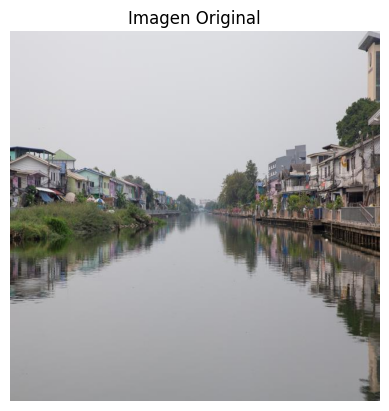

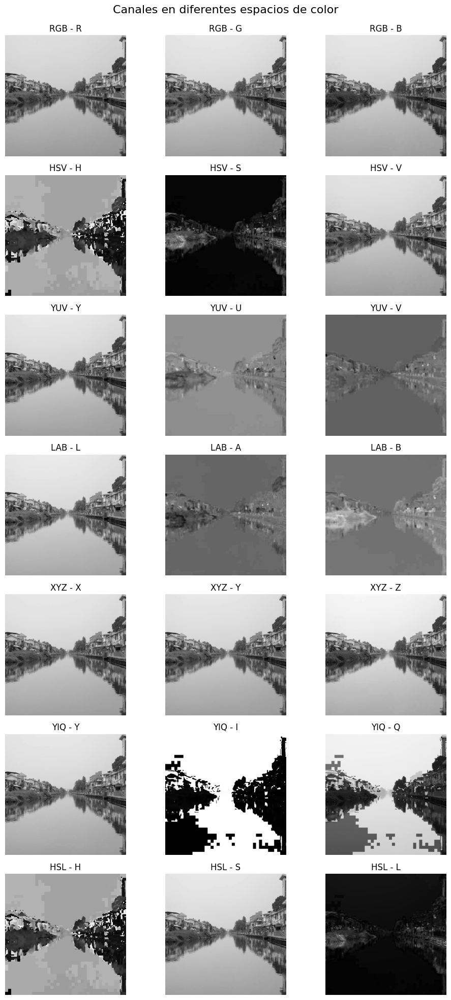

In [16]:
# Mostrar canales en diferentes espacios de color
show_image(img_read(imgLimpia), title="Imagen Original")
mostrar_canales_espacios_de_color(imgLimpia)

##### Espacios de color imagen agua sequia


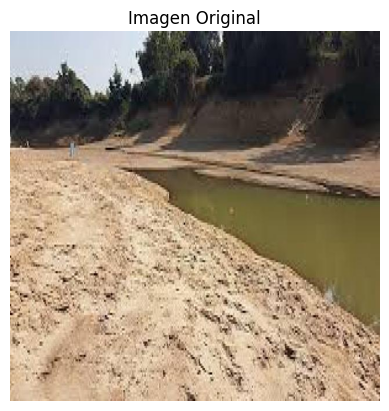

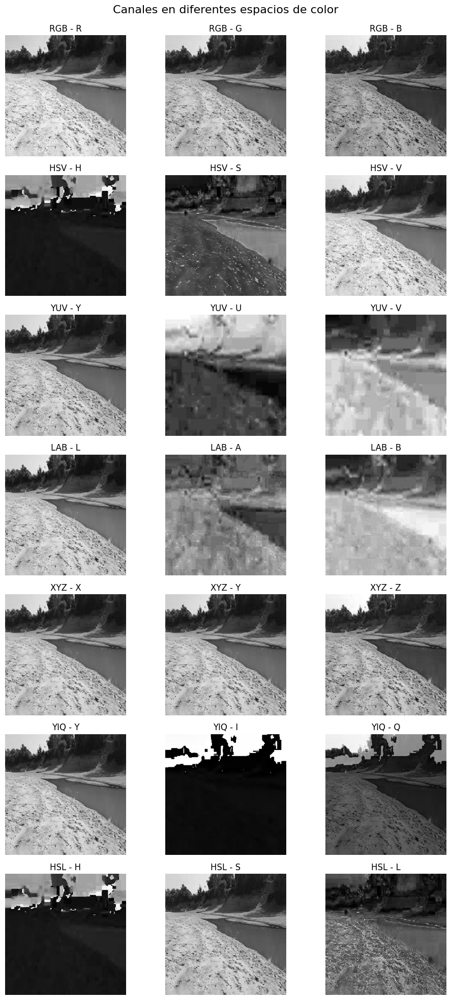

In [17]:
show_image(img_read(imgSequia), title="Imagen Original")
mostrar_canales_espacios_de_color(imgSequia)

##### Espacios de color imagen agua aceite


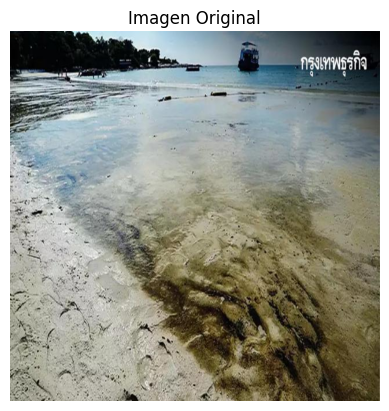

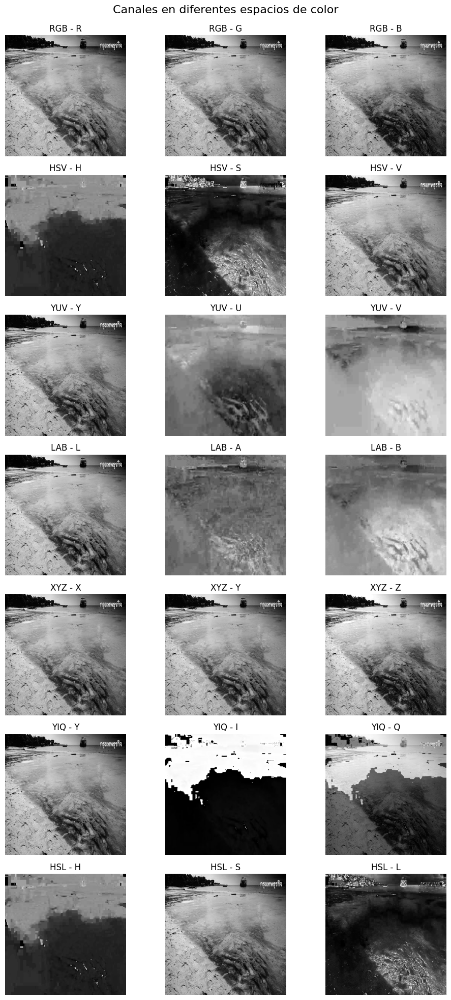

In [18]:
show_image(img_read(imgAceite), title="Imagen Original")
mostrar_canales_espacios_de_color(imgAceite)

##### Espacios de color imagen agua basura


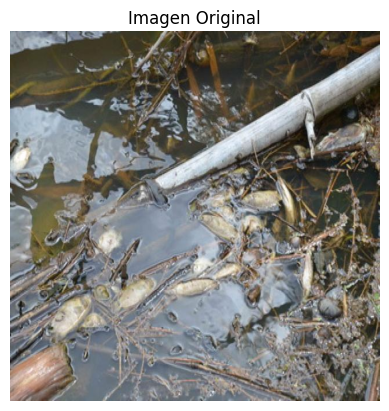

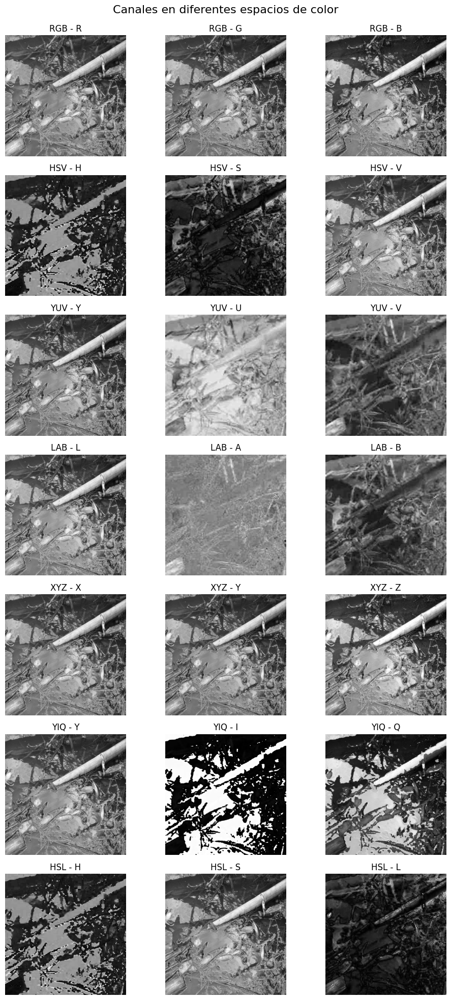

In [19]:
show_image(img_read(imgBasura), title="Imagen Original")
mostrar_canales_espacios_de_color(imgBasura)

##### Espacios de color imagen agua quimicos


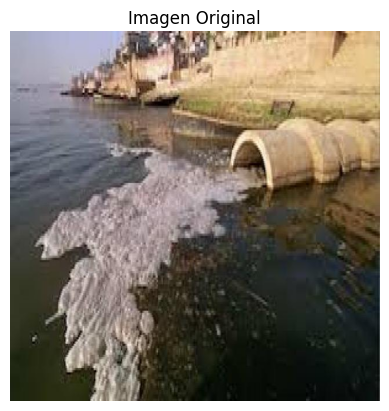

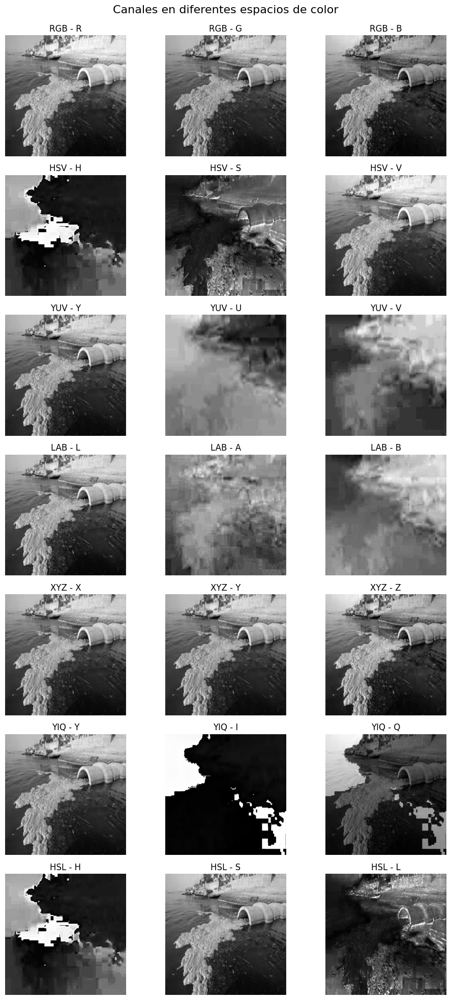

In [20]:
show_image(img_read(imgQuimico), title="Imagen Original")
mostrar_canales_espacios_de_color(imgQuimico)

### Mejores Canales para Resaltar Detalles de Color:

S (HSL): Este canal será ideal para destacar colores vivos, ya que se enfoca exclusivamente en la saturación. Permite una percepción clara de las áreas más vibrantes de la imagen, haciéndolo útil cuando se quiere analizar la riqueza cromática.

V (HSV): Ofrece una excelente representación de los tonos rojos, lo cual puede ser ventajoso en imágenes con colores cálidos predominantes. A menudo, proporciona una mejor percepción de la intensidad de colores específicos, como los rojos.

RGB Completo para la Representación General:
Cuando se utilizan los tres canales de RGB simultáneamente, la imagen será la más cercana a la realidad percibida, pues el espacio RGB se ajusta bien a cómo el ojo humano procesa el color en general.

Aunque en general estas tres se parecen, no se visualiza que haya un determinado canal que resalte mucho mas que los otros las caracteristicas de la imagen.
Esto significa los objetos de estudio tienen características visualmente homogéneas o neutrales en términos de sus propiedades cromáticas.


#### Transformacion de las imagenes

A continuación se aplicarán algunas transformaciones a las imágenes con el fín de mejorar la calidad de las mismas


##### Correcion gamma

La corrección gamma es empleada para ajustar el brillo de una imagen mediante una transformación no lineal, lo que permite modificar la relación entre los valores de intensidad de la imagen y la forma en que estos se perciben visualmente


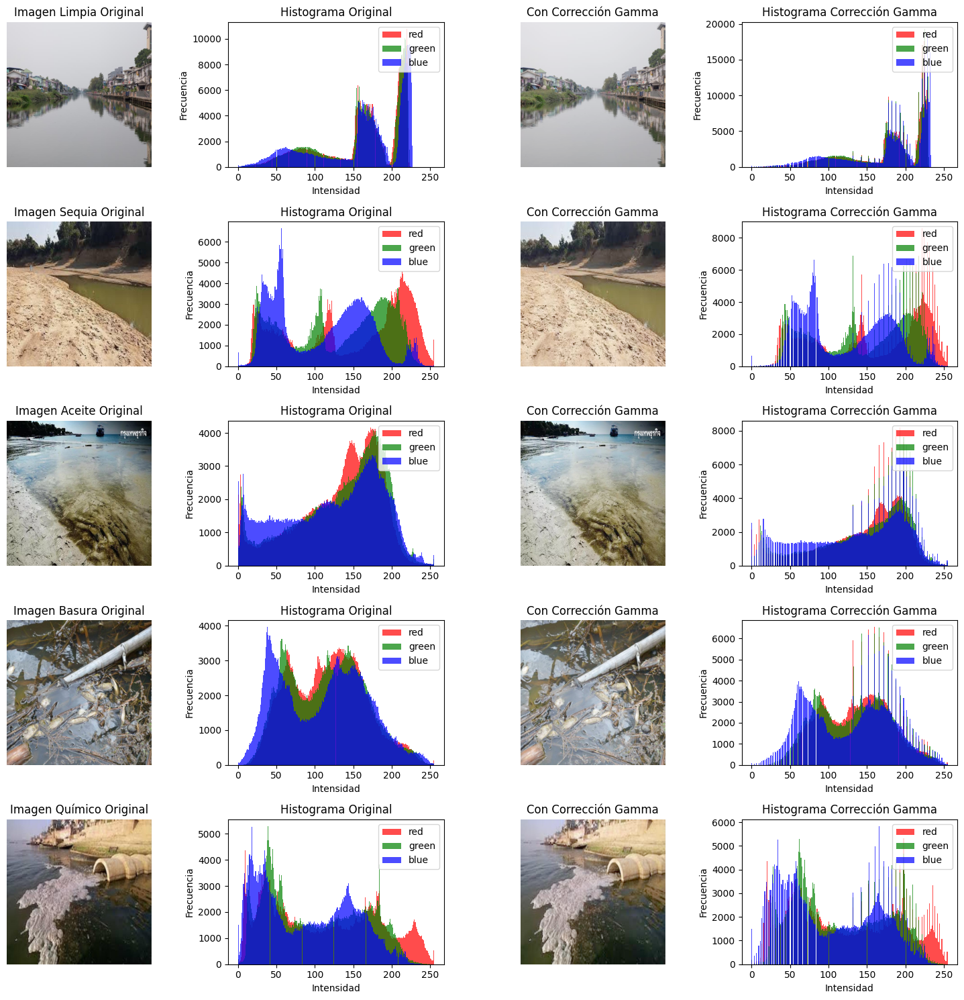

In [21]:
# Lista de imágenes y nombres para procesar
imagenes = [
    img_read(imgLimpia),
    img_read(imgSequia),
    img_read(imgAceite),
    img_read(imgBasura),
    img_read(imgQuimico),
]
nombres = [
    "Imagen Limpia",
    "Imagen Sequia",
    "Imagen Aceite",
    "Imagen Basura",
    "Imagen Químico",
]

# Aplicar corrección gamma
imagenes_corregidas = [apply_gamma_correction(img, gamma=0.75) for img in imagenes]

# Crear una figura para mostrar imágenes y sus histogramas
fig, axs = plt.subplots(len(imagenes), 4, figsize=(15, 15))

# Loop para mostrar las imágenes originales, corregidas y sus histogramas
for i in range(len(imagenes)):
    # Mostrar imagen original
    axs[i, 0].imshow(imagenes[i])
    axs[i, 0].set_title(nombres[i] + " Original")
    axs[i, 0].axis("off")

    # Mostrar histograma de la imagen original
    show_histogram(
        imagenes[i], ax=axs[i, 1], title="Histograma Original", color_space="rgb"
    )

    # Mostrar imagen con corrección gamma
    axs[i, 2].imshow(imagenes_corregidas[i])
    axs[i, 2].set_title("Con Corrección Gamma")
    axs[i, 2].axis("off")

    # Mostrar histograma de la imagen corregida
    show_histogram(
        imagenes_corregidas[i],
        ax=axs[i, 3],
        title="Histograma Corrección Gamma",
        color_space="rgb",
    )

# Ajustar el diseño para evitar solapamientos
plt.tight_layout()
plt.show()

Después de aplicar una corrección gamma de 0.75, la imagen se aclara, revelando más detalles en las áreas oscuras. Las sombras pierden contraste, lo que puede hacer que los objetos en esas zonas se vean más planos y menos definidos. Los colores en las sombras también pueden parecer desaturados, mientras que las áreas brillantes permanecen casi intactas. Esto genera una sensación general de mayor luminosidad, aunque con menor profundidad debido a la reducción de contraste en las sombras. Además, el ruido en las zonas oscuras puede disminuir, haciendo que la imagen luzca más suave.


##### Ecualizacion del histograma

La ecualización del histograma es una técnica utilizada para mejorar el contraste de una imagen al redistribuir los niveles de intensidad de los píxeles. Al hacer esto, se logra una mejor distribución de los valores de intensidad en todo el rango disponible, lo que resalta los detalles en áreas que podrían estar subexpuestas o sobreexpuestas. Este proceso es especialmente útil en imágenes donde el contraste es bajo, ya que permite que los detalles ocultos sean más visibles.

En nuestro proyecto, la ecualización del histograma se ha aplicado para cada clase de agua con el fin de mejorar la visibilidad de las características que podrían ser clave para la segmentación o detección de contaminantes


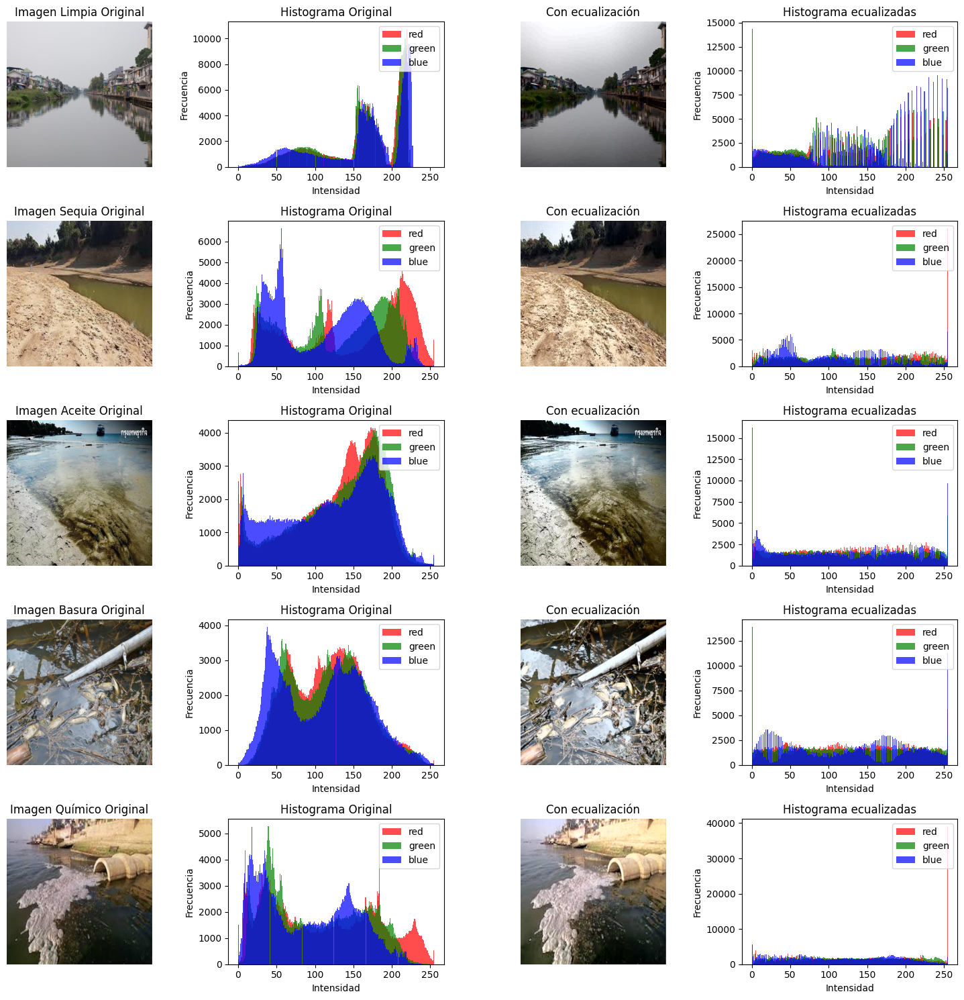

In [22]:
# Aplicar ecualizacion del histograma
imagenes_ecualizadas = [equalize_histogram(img) for img in imagenes]

# Crear una figura para mostrar imágenes y sus histogramas
fig, axs = plt.subplots(len(imagenes), 4, figsize=(15, 15))

# Loop para mostrar las imágenes originales, ecualizadas y sus histogramas
for i in range(len(imagenes)):
    # Mostrar imagen original
    axs[i, 0].imshow(imagenes[i])
    axs[i, 0].set_title(nombres[i] + " Original")
    axs[i, 0].axis("off")

    # Mostrar histograma de la imagen original
    show_histogram(
        imagenes[i], ax=axs[i, 1], title="Histograma Original", color_space="rgb"
    )

    # Mostrar imagen ecualizada
    axs[i, 2].imshow(imagenes_ecualizadas[i])
    axs[i, 2].set_title("Con ecualización")
    axs[i, 2].axis("off")

    # Mostrar histograma de la imagen ecualizada
    show_histogram(
        imagenes_ecualizadas[i],
        ax=axs[i, 3],
        title="Histograma ecualizadas",
        color_space="rgb",
    )

# Ajustar el diseño para evitar solapamientos
plt.tight_layout()
plt.show()

Al someter las imagenes a este proceso, el contraste mejora significativamente, especialmente en las áreas de brillo intermedio. Las sombras se aclaran y las luces altas se oscurecen ligeramente, equilibrando la distribución tonal en toda la imagen. Esto revela más detalles en zonas tanto oscuras como claras, que antes podrían haber estado ocultos. Los colores se vuelven más vibrantes y definidos, ya que la ecualización distribuye mejor los niveles de luz. El resultado es una imagen más equilibrada y detallada, con mayor contraste y una representación más uniforme de los tonos a lo largo de toda la escala de brillo.


##### Aplicar filtros de reduccion de ruido

Los filtros de reducción de ruido son esenciales para mejorar la calidad de las imágenes al suavizar detalles innecesarios (ruido) que pueden afectar negativamente los resultados de procesamiento posteriores, como la segmentación y la extracción de características.


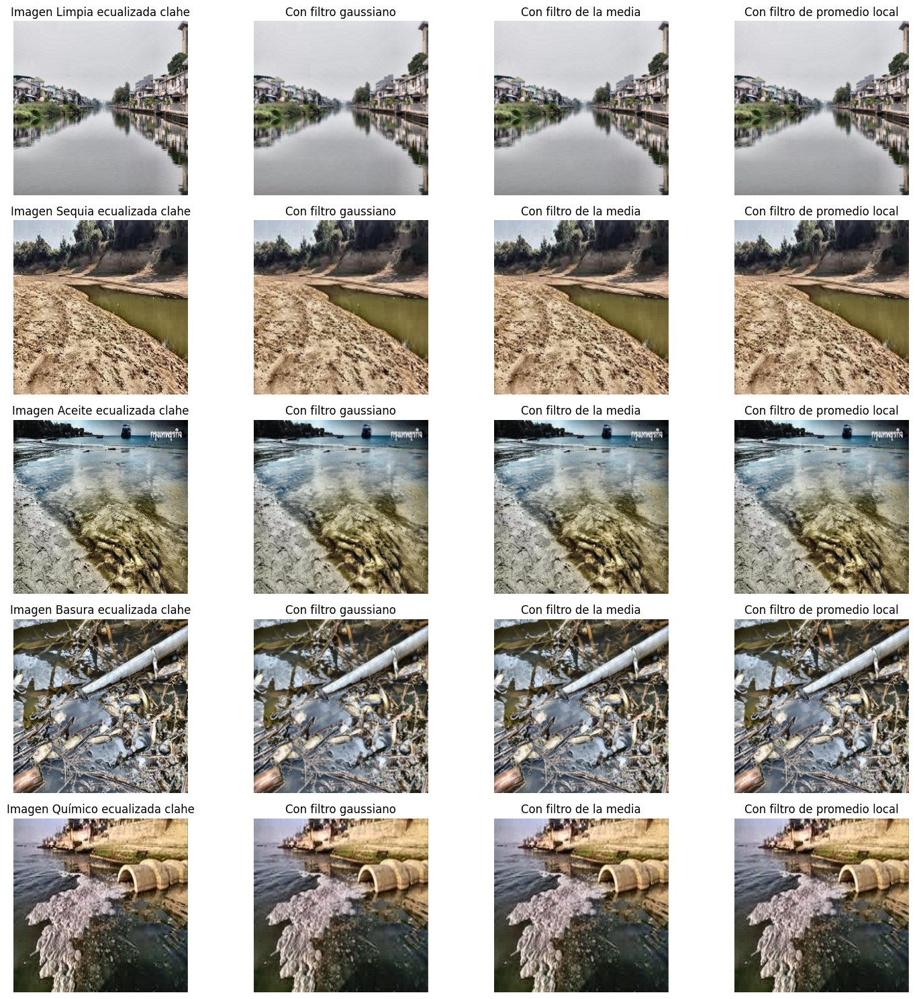

In [23]:
# Aplicar filtro gaussiano, de la media y de promedio local a imagenes ecualizadas clahe (Ecualización del histograma con límite de contraste)
imagenes_ecualizadas_clahe = [apply_clahe(img) for img in imagenes]

imagenes_gaussiano = [apply_gaussian_blur(img) for img in imagenes_ecualizadas_clahe]
imagenes_media = [apply_mean_filter(img) for img in imagenes_ecualizadas_clahe]
imagenes_promedio = [
    apply_local_average_filter(img) for img in imagenes_ecualizadas_clahe
]

# Crear una figura para mostrar imágenes
fig, axs = plt.subplots(len(imagenes_ecualizadas_clahe), 4, figsize=(15, 15))

# Loop para mostrar las imágenes
for i in range(len(imagenes_ecualizadas_clahe)):
    # Mostrar imagen original
    axs[i, 0].imshow(imagenes_ecualizadas_clahe[i])
    axs[i, 0].set_title(nombres[i] + " ecualizada clahe")
    axs[i, 0].axis("off")

    # Mostrar imagen con filtro gaussiano
    axs[i, 1].imshow(imagenes_gaussiano[i])
    axs[i, 1].set_title("Con filtro gaussiano")
    axs[i, 1].axis("off")

    # Mostrar imagen con filtro de la media
    axs[i, 2].imshow(imagenes_media[i])
    axs[i, 2].set_title("Con filtro de la media")
    axs[i, 2].axis("off")

    # Mostrar imagen con filtro de promedio local
    axs[i, 3].imshow(imagenes_promedio[i])
    axs[i, 3].set_title("Con filtro de promedio local")
    axs[i, 3].axis("off")

# Ajustar el diseño para evitar solapamientos
plt.tight_layout()
plt.show()

Al aplicar un filtro gaussiano a imágenes de agua con contaminantes, se suavizan las texturas, haciendo que tanto las impurezas como los detalles del agua limpia se vean borrosos, ocultando los contaminantes pequeños.

El filtro de la media reduce el ruido, pero puede mezclar las partículas contaminantes, dificultando su identificación.

Con el filtro promedio local, se suavizan las áreas homogéneas del agua limpia y se preservan los bordes de los contaminantes más grandes, mejorando su detección.

La ecualización CLAHE intensifica el contraste en las áreas de agua limpia y sucia, realzando la visibilidad de las partículas contaminantes y los detalles finos.


##### imagenes preprocesadas


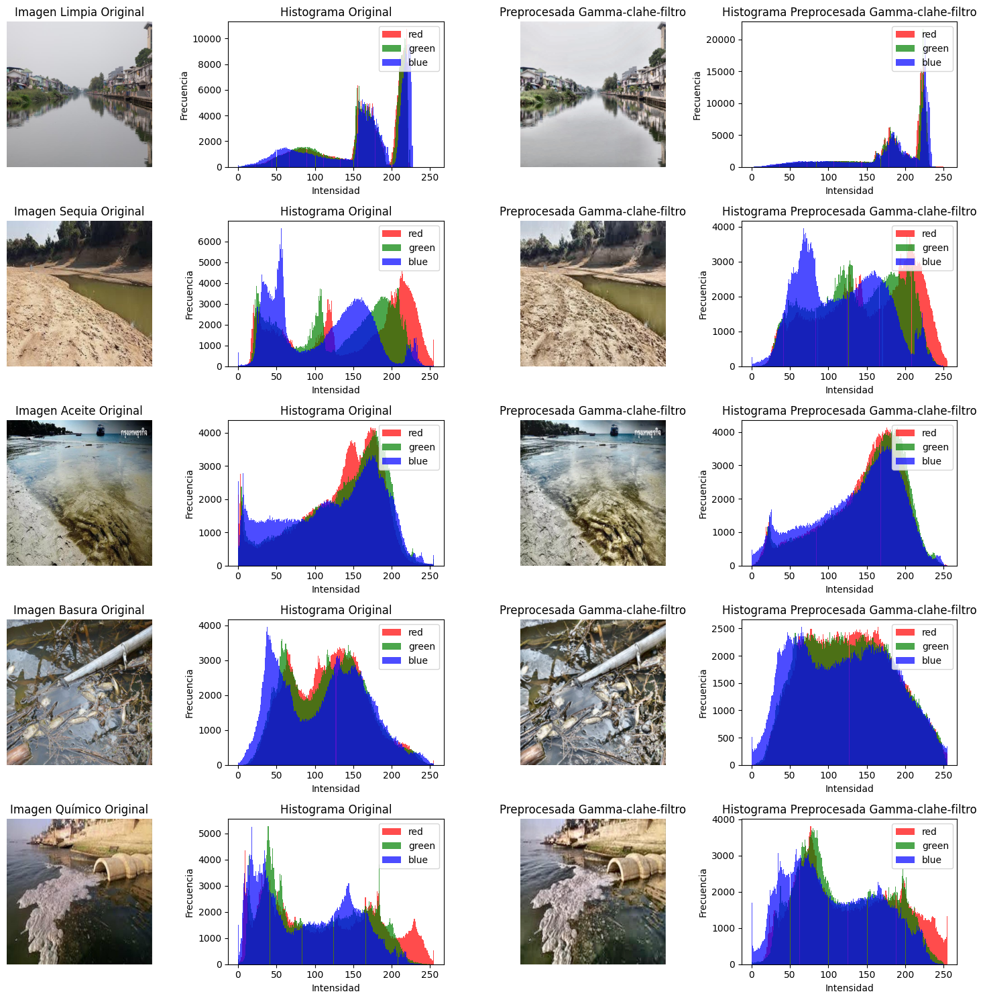

In [24]:
# Aplicar corrección gamma, ecualización del histograma con límite de contraste (CLAHE) y filtro de promedio local a las imágenes
imagenes_gamma_clahe = [apply_clahe(img) for img in imagenes_corregidas]
imagenes_preprocesadas = [
    apply_local_average_filter(img) for img in imagenes_gamma_clahe
]

# Crear una figura para mostrar imágenes y sus histogramas
fig, axs = plt.subplots(len(imagenes), 4, figsize=(15, 15))

# Loop para mostrar las imágenes originales, preprocesadas y sus histogramas
for i in range(len(imagenes)):
    # Mostrar imagen original
    axs[i, 0].imshow(imagenes[i])
    axs[i, 0].set_title(nombres[i] + " Original")
    axs[i, 0].axis("off")

    # Mostrar histograma de la imagen original
    show_histogram(
        imagenes[i], ax=axs[i, 1], title="Histograma Original", color_space="rgb"
    )

    # Mostrar imagen preprocesada
    axs[i, 2].imshow(imagenes_preprocesadas[i])
    axs[i, 2].set_title("Preprocesada Gamma-clahe-filtro")
    axs[i, 2].axis("off")

    # Mostrar histograma de la imagen preprocesada
    show_histogram(
        imagenes_preprocesadas[i],
        ax=axs[i, 3],
        title="Histograma Preprocesada Gamma-clahe-filtro",
        color_space="rgb",
    )

# Ajustar el diseño para evitar solapamientos
plt.tight_layout()
plt.show()

Al comparar ambos histogramas se observan diferencias significativas en la distribución de los tonos. En la imagen normal, los histogramas pueden mostrar picos concentrados en ciertas áreas, indicando que los tonos oscuros o claros predominan, lo que puede resultar en una pérdida de detalles en regiones específicas. En contraste, la imagen ecualizada presentará un histograma más distribuido, con picos más equilibrados a lo largo del rango tonal. Esto refleja una mejora en el contraste y una representación más rica de los colores, lo que permite una mejor visualización de los detalles en todas las áreas de la imagen.


### Segmentación

En la etapa de segmentación del proyecto, hemos aplicado tres métodos clave para separar las diferentes regiones de las imágenes y aislar las áreas de interés.


#### Segmentacion por Watershed

El algoritmo de Watershed es una técnica de segmentación basada en regiones, que trata la imagen como una topografía, donde los píxeles de menor valor de intensidad representan los valles. El algoritmo simula cómo el agua llenaría estos valles, marcando las diferentes cuencas de manera separada.


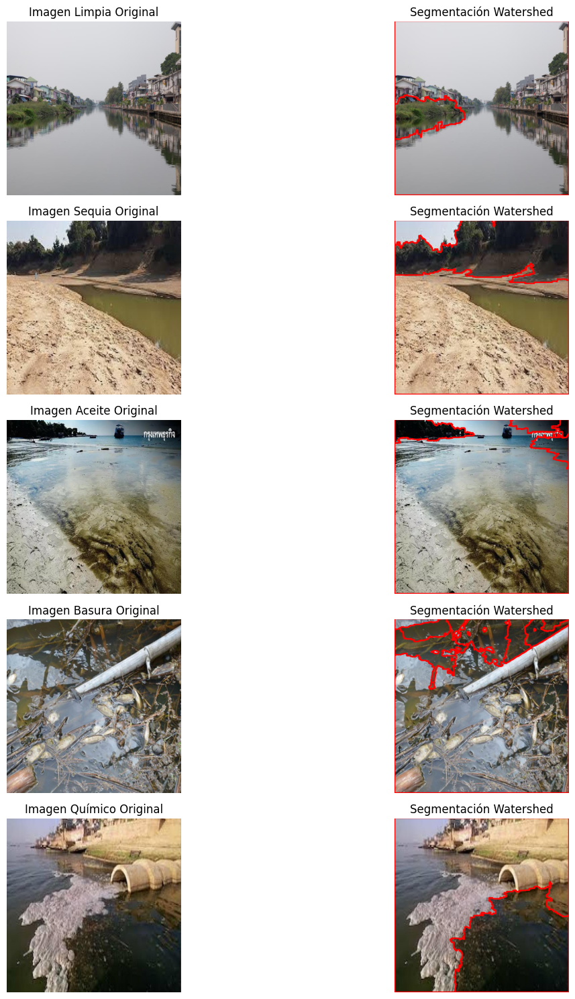

In [25]:
imagenes_Watershed = [watershed_segmentation(img, 5) for img in imagenes]

# Crear una figura para mostrar imágenes originales y segmentadas
fig, axs = plt.subplots(len(imagenes), 2, figsize=(15, 15))

# Loop para mostrar las imágenes originales y segmentadas
for i in range(len(imagenes)):
    # Mostrar imagen original
    axs[i, 0].imshow(imagenes[i])
    axs[i, 0].set_title(nombres[i] + " Original")
    axs[i, 0].axis("off")

    # Mostrar imagen con segmentación Watershed
    axs[i, 1].imshow(imagenes_Watershed[i])
    axs[i, 1].set_title("Segmentación Watershed")
    axs[i, 1].axis("off")

# Ajustar el diseño para evitar solapamientos
plt.tight_layout()
plt.show()

#### Segmentacion GrabCut

Este método interactivo de segmentación es ideal para separar el primer plano del fondo en imágenes. Se basa en un modelo de energía, donde el usuario define una región aproximada del objeto de interés y el algoritmo itera para refinar la segmentación.


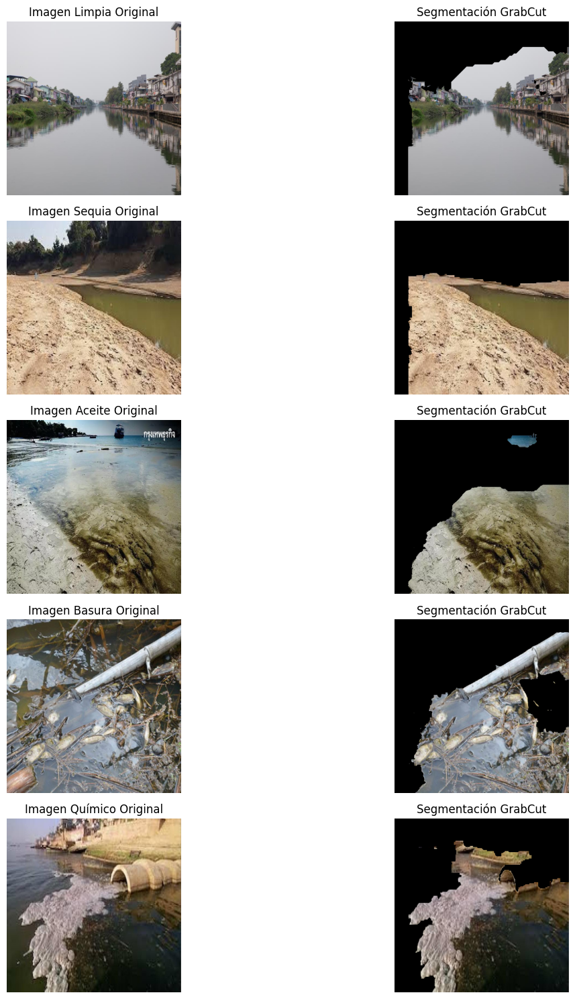

In [26]:
imagenes_grabcut = [grabcut_segmentation(img) for img in imagenes]

# Crear una figura para mostrar imágenes originales y segmentadas
fig, axs = plt.subplots(len(imagenes), 2, figsize=(15, 15))

# Loop para mostrar las imágenes originales y segmentadas
for i in range(len(imagenes)):
    # Mostrar imagen original
    axs[i, 0].imshow(imagenes[i])
    axs[i, 0].set_title(nombres[i] + " Original")
    axs[i, 0].axis("off")

    # Mostrar imagen con segmentación grabcut
    axs[i, 1].imshow(imagenes_grabcut[i])
    axs[i, 1].set_title("Segmentación GrabCut")
    axs[i, 1].axis("off")

# Ajustar el diseño para evitar solapamientos
plt.tight_layout()
plt.show()

#### Segmentacion K-means

K-means es un método de segmentación basado en clustering, donde los píxeles se agrupan en K clústeres de acuerdo con sus características de color o intensidad. Cada píxel es asignado al clúster cuyo centroide esté más cerca de él.


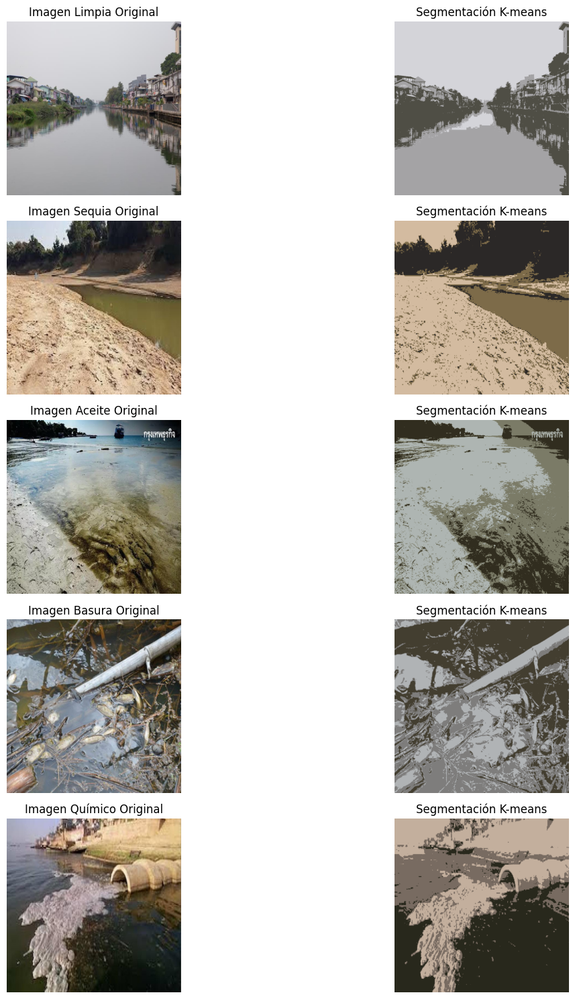

In [27]:
clusters = 3
imagenes_kmeans = [kmeans_segmentation(img, clusters) for img in imagenes]

# Crear una figura para mostrar imágenes originales y segmentadas
fig, axs = plt.subplots(len(imagenes), 2, figsize=(15, 15))

# Loop para mostrar las imágenes originales y segmentadas
for i in range(len(imagenes)):
    # Mostrar imagen original
    axs[i, 0].imshow(imagenes[i])
    axs[i, 0].set_title(nombres[i] + " Original")
    axs[i, 0].axis("off")

    # Mostrar imagen con segmentación K-means
    axs[i, 1].imshow(imagenes_kmeans[i])
    axs[i, 1].set_title("Segmentación K-means")
    axs[i, 1].axis("off")

# Ajustar el diseño para evitar solapamientos
plt.tight_layout()
plt.show()

La segmentacion K-means aplicandola sobre la "imagen quimico", "imagen basura" y " imagen sequia", se puede diferenciar mas los objetos de interes de la imagen, dandonos mas contraste entre los contaminantes y lo demas de la imgaen, pero al aplicarlo sobre las imagenes de agua limpia y aceite, estas pierden totalmente su definicion, a estas les vino mejor una grabcut para la "imagen limpia" y una watershed para la "imagen aceite" en las cuales se pudieron separar las regiones de agua limpia o la region contaminada con aceite del resto de la imagen


### Extraccion de caracteristicas

En la etapa de extracción de características, el objetivo principal fue obtener representaciones numéricas de las imágenes que permitieran capturar información clave sobre su contenido, lo que es esencial para las tareas de clasificación y análisis posterior


HOG es una técnica de extracción de características que se centra en los gradientes de intensidad de una imagen, capturando la estructura y forma de los objetos mediante la distribución de bordes y contornos.


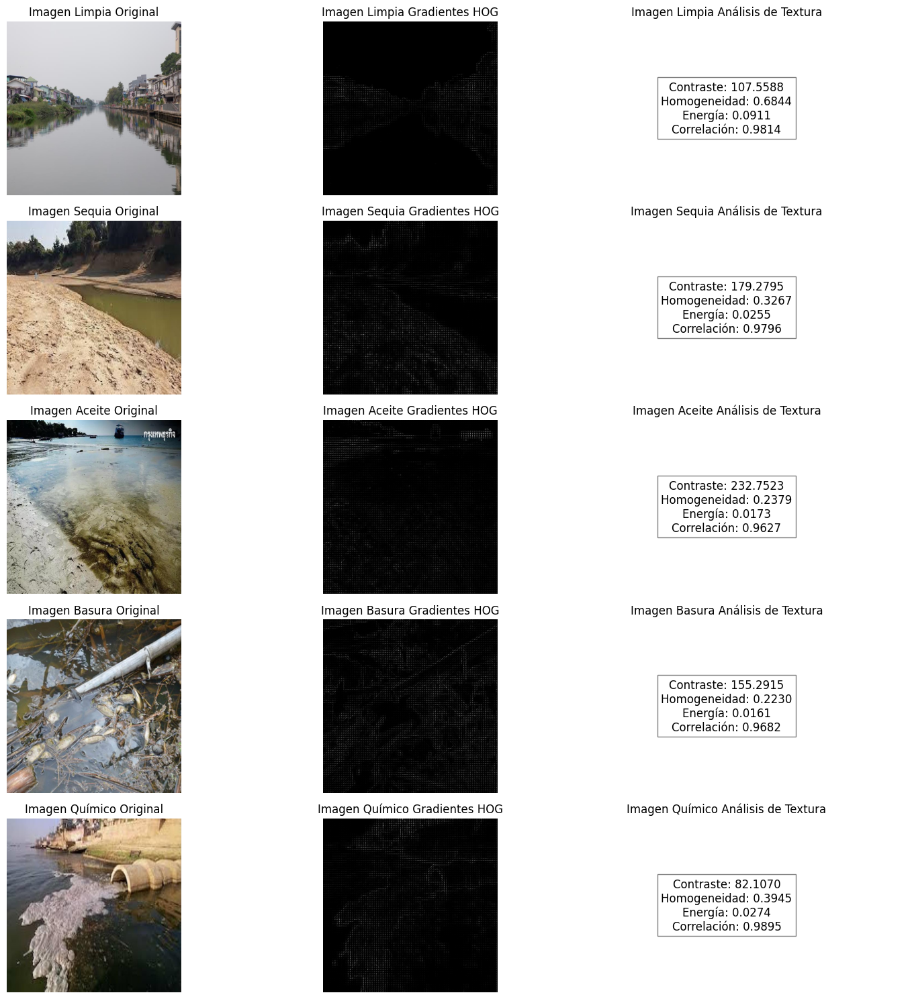

In [28]:
# Extraer características HOG y de textura de cada imagen
imagenes_features = [extract_hog_features(img) for img in imagenes]
texturas = [analyze_texture(img) for img in imagenes]

# Crear una figura para mostrar las imágenes originales, gradientes HOG y características de textura
fig, axs = plt.subplots(len(imagenes), 3, figsize=(15, 15))

for i in range(len(imagenes)):
    # Mostrar imagen original
    axs[i, 0].imshow(imagenes[i])
    axs[i, 0].set_title(f"{nombres[i]} Original")
    axs[i, 0].axis("off")

    # Mostrar imagen con gradientes HOG
    axs[i, 1].imshow(imagenes_features[i][1], cmap="gray")
    axs[i, 1].set_title(f"{nombres[i]} Gradientes HOG")
    axs[i, 1].axis("off")

    # Mostrar análisis de textura
    textura_info = "\n".join([f"{k}: {v:.4f}" for k, v in texturas[i].items()])
    axs[i, 2].text(
        0.5,
        0.5,
        textura_info,
        fontsize=12,
        va="center",
        ha="center",
        bbox=dict(facecolor="white", alpha=0.5),
    )
    axs[i, 2].set_title(f"{nombres[i]} Análisis de Textura")
    axs[i, 2].axis("off")

# Ajustar el diseño para evitar solapamientos
plt.tight_layout()
plt.show()

### Las caracteristicas de la imagen rondan valores similares, de estos se puede concluir:

Contraste entre (82, 239):
Un alto contraste indica una imagen clara y detallada, ideal para visualizar elementos específicos, como objetos sumergidos en agua. Este tipo de contraste sugiere una gran diferencia entre las áreas claras y oscuras, resultando en detalles y texturas bien definidos. En cambio, un bajo contraste refleja una imagen más uniforme y menos informativa, donde los detalles se ven menos claros y más mezclados. Este nivel reducido de contraste sugiere una menor diferencia entre las intensidades, lo que podría señalar una calidad de agua deficiente o una pérdida significativa de información visual.

Homogeneidad entre (0.2379, 0.6844) La homogeneidad en imágenes es un indicador clave de la calidad del agua. Una alta homogeneidad sugiere patrones uniformes, típicos de agua limpia, mientras que una baja homogeneidad indica variaciones que pueden señalar contaminantes. Esto último está relacionado con un mayor contraste y menor energía, sugiriendo una calidad de agua deficiente.

Energia, muy baja:
Las imágenes con energía tan baja muestran una textura muy variable y compleja, indicando una gran cantidad de detalles irregulares. En el contexto del agua, esto sugiere contaminación, con partículas que generan una apariencia desordenada. Este bajo valor de energía se asocia con un alto contraste, dificultando la identificación de objetos y señalando una mala calidad del agua.


### Red Neuronal CNN

En el proyecto, se diseñó e implementó una Red Neuronal Convolucional (CNN) para realizar la clasificación de las imágenes en cinco clases, correspondientes a los diferentes tipos de agua: agua clara normal, agua en sequía, agua contaminada con aceite, agua contaminada con basura y agua contaminada por químicos.
La arquitectura de la CNN se basó en varias capas convolucionales seguidas de capas de max-pooling y capas densas totalmente conectadas al final. Esta estructura permitió que el modelo capturara tanto características espaciales (mediante convoluciones) como patrones globales (a través de las capas densas) para la clasificación.


#### Definimos las carpetas de entrenamiento y de prueba


In [29]:
base_dir = os.path.join(RUTA_TRAIN)
print("Carpetas Entreno--> ", os.listdir(base_dir))
base_dir = os.path.join(RUTA_TEST)
print("Carpetas Testeo--> ", os.listdir(base_dir))

Carpetas Entreno-->  [' chemical-water', ' polluted-water', ' oil-contaminated-water', ' normal-water', ' dry-water']
Carpetas Testeo-->  [' oil-contaminated-water', ' normal-water', ' polluted-water', ' chemical-water', ' dry-water']


#### Data augmentation

Data Augmentation es una técnica utilizada en el preprocesamiento de datos para aumentar artificialmente el tamaño y la diversidad de un conjunto de datos de imágenes, lo que ayuda a mejorar la generalización del modelo. Para este proyecto, se aplicó data augmentation para enriquecer el conjunto de imágenes de entrenamiento, añadiendo variaciones que permitan al modelo aprender características más robustas y evitar el sobreajuste.


In [30]:
# Creamos nuestros generadores de imagenes
train_datagen = ImageDataGenerator(
    rescale=1.0
    / 255,  # Es para hacer que todos los valores de pixeles esten de cero a uno
    rotation_range=40,
    width_shift_range=0.2,  # Cambiar el ancho de la imagen en un 20%
    height_shift_range=0.2,  # Cambiar la altura de la imagen en un 20%
    shear_range=0.2,  # Rotación a través del eje X en un 20%
    zoom_range=0.2,  # Zoom de imagen en un 20%
    horizontal_flip=True,  # Toma una imagen y la invierte
    fill_mode="nearest",  # rellena la imagen es decir la suaviza
)

# Generador imagenes de entrenamiento
test_datagen = ImageDataGenerator(rescale=1.0 / 255)  # solo reescalamos las imagenes

In [31]:
# Ahora creamos las imagenes para entrenar
entreno_imagenes = train_datagen.flow_from_directory(
    RUTA_TRAIN,
    target_size=(256, 256),
    batch_size=128,  # Tamaño de los lotes de entreno
    class_mode="categorical",  # clasificación categorica, es decir a 4 nombres de enfermedades
)

# Ahora creamos las imagenes para validar
validacion_imagenes = test_datagen.flow_from_directory(
    RUTA_TEST,
    target_size=(256, 256),
    batch_size=10,
    class_mode="categorical",  # clasificación categorica, es decir a 4 nombres de enfermedades
)

# esto hace que el generador de imagen entre a nuestras carpetas de entreno y procese cada una

Found 180 images belonging to 5 classes.
Found 20 images belonging to 5 classes.


In [32]:
class myCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs={}):
        if logs.get("accuracy") > 0.80:
            print("\nReached 80% accuracy so cancelling training!")
            self.model.stop_training = True


callbacks = myCallback()

#### 1. Entrada de la Red:

- Tamaño de las imágenes: Las imágenes de entrada se redujeron a un tamaño de 256x256 píxeles con 3 canales (RGB).
- Número de clases: La salida de la red fue configurada para 5 clases correspondientes a los tipos de contaminación de agua.

2. Capas Convolucionales:

- Se utilizaron varias capas convolucionales con filtros de diferentes tamaños para extraer características de bajo nivel como bordes, texturas y formas.
- Después de cada convolución, se aplicó una función de activación ReLU para introducir no linealidades en el modelo.
- Cada capa convolucional fue seguida de una operación de max-pooling para reducir la dimensionalidad de las imágenes de salida y mantener solo las características más relevantes.

3. Capas Densas:

- Tras las capas convolucionales, se aplanaron las características para alimentar una capa densa completamente conectada con 512 neuronas.
- Para evitar el sobreajuste, se añadió una capa de Dropout con una tasa del 50%, lo que ayuda a regularizar el modelo al desactivar aleatoriamente algunas neuronas durante el entrenamiento.

4. Capa de Salida:

- La capa de salida consiste en 5 neuronas (una por clase) con una función de activación softmax para obtener probabilidades de clasificación para cada clase.


**Compilación del Modelo:**

El modelo fue compilado utilizando el optimizador Adam por su eficiencia en el ajuste de los pesos durante el entrenamiento. Para la función de pérdida, se utilizó categorical_crossentropy, dado que estamos tratando con una tarea de clasificación multiclase. Además, se utilizó la métrica de accuracy para evaluar el rendimiento del modelo durante el entrenamiento.


**Entrenamiento del Modelo:**

El modelo fue entrenado en un conjunto de imágenes de entrenamiento mediante un generador de datos que permite el aumento de datos (data augmentation) para mejorar la generalización del modelo. Se utilizó una estrategia de Early Stopping para detener el entrenamiento si la pérdida de validación no mejoraba después de 10 épocas, evitando así el sobreajuste.


In [33]:
# Parámetros de entrada
input_shape = (
    256,
    256,
    3,
)  # Tamaño de las imágenes reducidas(256, 256) con 3 canales (RGB)
num_classes = 5  # Número de clases

# Crear el modelo secuencial
model = Sequential()

# Primera capa convolucional + MaxPooling
model.add(Conv2D(32, (3, 3), activation="relu", input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))

# Segunda capa convolucional + MaxPooling
model.add(Conv2D(64, (3, 3), activation="relu"))
model.add(MaxPooling2D(pool_size=(2, 2)))

# Tercera capa convolucional + MaxPooling
model.add(Conv2D(128, (3, 3), activation="relu"))
model.add(MaxPooling2D(pool_size=(2, 2)))

# Cuarta capa convolucional + MaxPooling
model.add(Conv2D(128, (3, 3), activation="relu"))
model.add(MaxPooling2D(pool_size=(2, 2)))

# Aplanar las características
model.add(Flatten())

# Capa densa completamente conectada
model.add(Dense(512, activation="relu"))

# Regularización con Dropout para evitar overfitting
model.add(Dropout(0.5))

# Capa de salida con activación softmax (para clasificación multiclase)
model.add(Dense(num_classes, activation="softmax"))

# Disminuir el learning rate
optimizer = Adam(learning_rate=0.0001)

# Compilar el modelo
model.compile(
    optimizer="adam",
    loss="categorical_crossentropy",  # Cambia a 'sparse_categorical_crossentropy' si los labels no están one-hot encoded
    metrics=["accuracy"],
)

# Detener el entrenamiento si no mejora después de cierto número de épocas
early_stop = EarlyStopping(
    monitor="accuracy", patience=10, verbose=1, restore_best_weights=True
)

# Entrenar el modelo
history = model.fit(
    entreno_imagenes,  # Generador de datos de entrenamiento
    epochs=32,
    steps_per_epoch=512,
    validation_data=validacion_imagenes,  # Generador de datos de validación
    validation_steps=32,
    callbacks=[callbacks, early_stop],
    verbose=1,
)

# Mostrar la estructura del modelo
model.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/32


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


  2/512 ━━━━━━━━━━━━━━━━━━━━ 1:23:55 10s/step - accuracy: 0.1988 - loss: 1.7778

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


512/512 ━━━━━━━━━━━━━━━━━━━━ 42s 37ms/step - accuracy: 0.1945 - loss: 1.9350 - val_accuracy: 0.2000 - val_loss: 1.6224
Epoch 2/32
512/512 ━━━━━━━━━━━━━━━━━━━━ 4s 978us/step - accuracy: 0.2167 - loss: 1.6340 - val_accuracy: 0.1500 - val_loss: 1.6073
Epoch 3/32
512/512 ━━━━━━━━━━━━━━━━━━━━ 7s 989us/step - accuracy: 0.2111 - loss: 1.6109 - val_accuracy: 0.1000 - val_loss: 1.6198
Epoch 4/32
512/512 ━━━━━━━━━━━━━━━━━━━━ 8s 801us/step - accuracy: 0.2112 - loss: 1.6121 - val_accuracy: 0.1500 - val_loss: 1.6221
Epoch 5/32
512/512 ━━━━━━━━━━━━━━━━━━━━ 7s 1ms/step - accuracy: 0.2388 - loss: 1.5958 - val_accuracy: 0.1500 - val_loss: 1.6058
Epoch 6/32
512/512 ━━━━━━━━━━━━━━━━━━━━ 9s 987us/step - accuracy: 0.3110 - loss: 1.5713 - val_accuracy: 0.3000 - val_loss: 1.5565
Epoch 7/32
512/512 ━━━━━━━━━━━━━━━━━━━━ 7s 497us/step - accuracy: 0.3000 - loss: 1.5476 - val_accuracy: 0.3500 - val_loss: 1.4820
Epoch 8/32
512/512 ━━━━━━━━━━━━━━━━━━━━ 9s 820us/step - accuracy: 0.3056 - loss: 1.5482 - val_accuracy:

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 254, 254, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 127, 127, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 125, 125, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 62, 62, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 60, 60, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 30, 30, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 28, 28, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 14, 14, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 512)                 │      12,845,568 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 5)                   │           2,565 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 39,266,897 (149.79 MB)

 Trainable params: 13,088,965 (49.93 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 26,177,932 (99.86 MB)

In [ ]:
from tensorflow.keras.models import load_model

# Cargar el modelo guardado
# model = load_model('best_model.h5')

# Verificar la arquitectura del modelo
# model.summary()

In [34]:
loss, accuracy = model.evaluate(validacion_imagenes)
print(f"Pérdida: {loss}")
print(f"Precisión: {accuracy}")

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step - accuracy: 0.5667 - loss: 1.6352
Pérdida: 1.5823495388031006
Precisión: 0.550000011920929


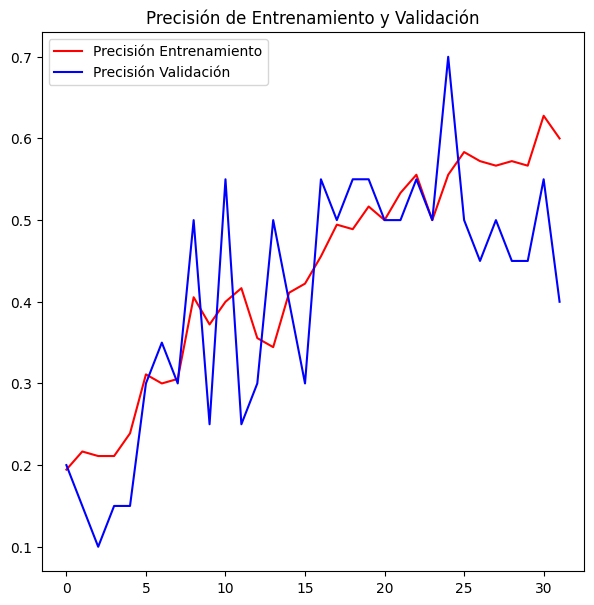

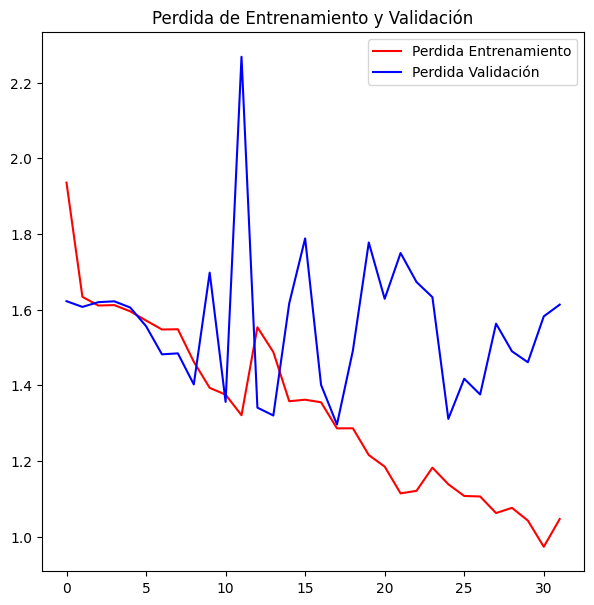

In [35]:
acc = history.history["accuracy"]
val_acc = history.history["val_accuracy"]
loss = history.history["loss"]
val_loss = history.history["val_loss"]

epochs = range(len(acc))

plt.figure(figsize=(7, 7))

plt.plot(epochs, acc, "r", label="Precisión Entrenamiento")
plt.plot(epochs, val_acc, "b", label="Precisión Validación")
plt.title("Precisión de Entrenamiento y Validación")
plt.legend()

plt.figure(figsize=(7, 7))

plt.plot(epochs, loss, "r", label="Perdida Entrenamiento")
plt.plot(epochs, val_loss, "b", label="Perdida Validación")
plt.title("Perdida de Entrenamiento y Validación")
plt.legend()

plt.show()

**Resultados y Evaluación:**

Después del entrenamiento, la red CNN logró una precisión moderada del 55% en la clasificación de las imágenes. Para mejorar este rendimiento, se plantean varias recomendaciones:

- Aumentar la cantidad de datos mediante técnicas como el aumento de datos, agregando más variabilidad en las imágenes.
- Ajustar la arquitectura: Agregar más capas convolucionales o aumentar el número de filtros podría ayudar al modelo a aprender características más complejas.
- Regularización adicional: Técnicas como la regularización L2 o más capas de Dropout pueden prevenir el sobreajuste.
- Optimización de hiperparámetros: Ajustar parámetros como la tasa de aprendizaje, el tamaño de los filtros y el número de épocas de entrenamiento.


In [36]:
# Guardar modelo
save_path = "best_model.h5"
model.save(save_path)

Finalmente, se generaron matrices de confusión para evaluar el rendimiento del modelo tanto en el conjunto de entrenamiento como en el de prueba, visualizadas mediante gráficos de Seaborn, lo que permitió identificar dónde el modelo cometió más errores.


In [37]:
# Evaluar en los datos de validación
y_pred = model.predict(validacion_imagenes)
y_pred_classes = np.argmax(y_pred, axis=1)
y_true = validacion_imagenes.classes

print(classification_report(y_true, y_pred_classes))
print(confusion_matrix(y_true, y_pred_classes))

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step  
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.00      0.00      0.00         4
           2       0.17      0.50      0.25         2
           3       0.33      0.33      0.33         3
           4       0.60      0.60      0.60         5

    accuracy                           0.25        20
   macro avg       0.22      0.29      0.24        20
weighted avg       0.22      0.25      0.23        20

[[0 3 3 0 0]
 [0 0 1 2 1]
 [0 1 1 0 0]
 [0 0 1 1 1]
 [1 1 0 0 3]]


2/2 ━━━━━━━━━━━━━━━━━━━━ 11s 2s/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


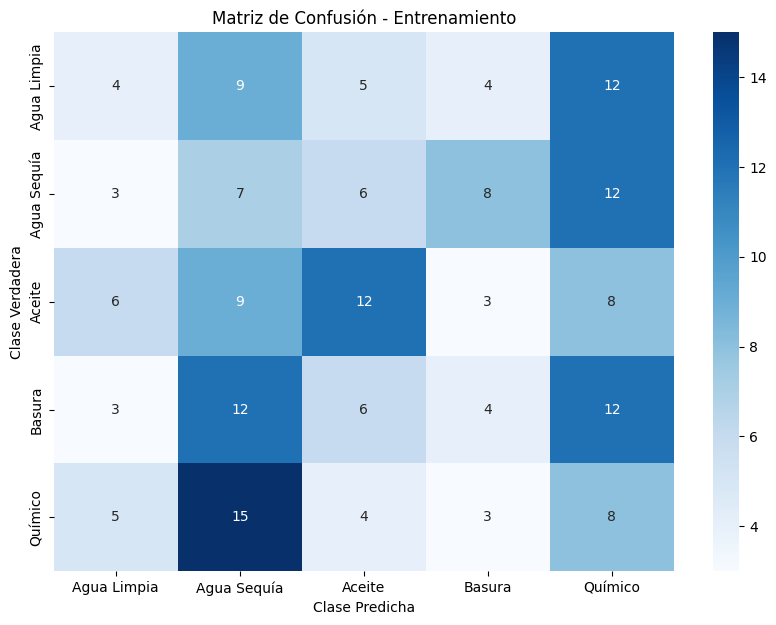

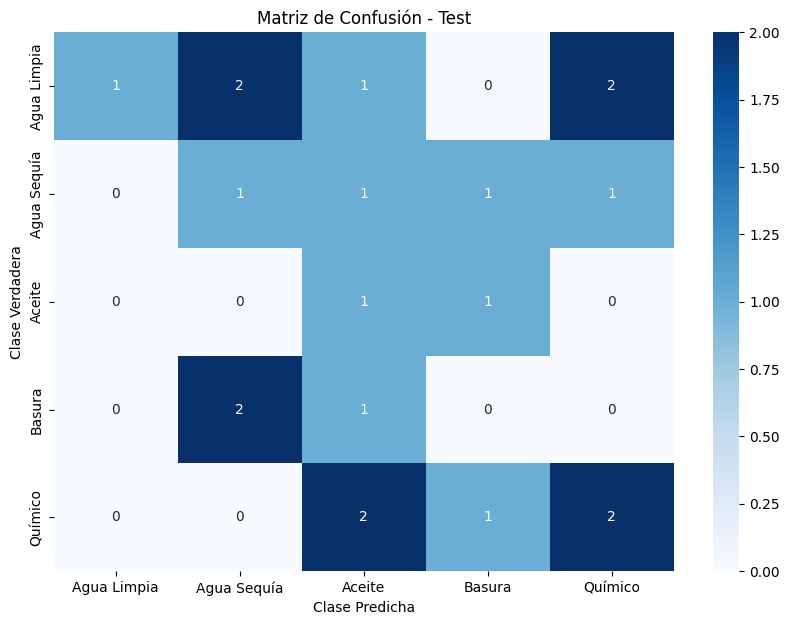

In [38]:
# Generar predicciones en el conjunto de entrenamiento
train_pred = model.predict(entreno_imagenes)
train_pred_classes = np.argmax(train_pred, axis=1)
train_true_classes = entreno_imagenes.classes

# Generar predicciones en el conjunto de prueba (test)
test_pred = model.predict(validacion_imagenes)
test_pred_classes = np.argmax(test_pred, axis=1)
test_true_classes = validacion_imagenes.classes

# Crear las matrices de confusión
conf_matrix_train = confusion_matrix(train_true_classes, train_pred_classes)
conf_matrix_test = confusion_matrix(test_true_classes, test_pred_classes)


# Función para graficar la matriz de confusión
def plot_confusion_matrix(cm, class_names, title="Matriz de Confusión"):
    plt.figure(figsize=(10, 7))
    sns.heatmap(
        cm,
        annot=True,
        fmt="d",
        cmap="Blues",
        xticklabels=class_names,
        yticklabels=class_names,
    )
    plt.title(title)
    plt.ylabel("Clase Verdadera")
    plt.xlabel("Clase Predicha")
    plt.show()


# Nombre de las clases
class_names = ["Agua Limpia", "Agua Sequía", "Aceite", "Basura", "Químico"]

# Graficar la matriz de confusión para el conjunto de entrenamiento
plot_confusion_matrix(
    conf_matrix_train, class_names, title="Matriz de Confusión - Entrenamiento"
)

# Graficar la matriz de confusión para el conjunto de prueba
plot_confusion_matrix(conf_matrix_test, class_names, title="Matriz de Confusión - Test")

La implementación de una red neuronal convolucional (CNN) ha sido un componente clave en el desarrollo de este proyecto, permitiendo la clasificación efectiva de imágenes en diferentes clases de agua contaminada.


## Conclusiones


El modelo presenta diferentes funciones especificamente pensadas para la óptima segmentación y clasificación de las condiciones del cuerpo de agua.

Inicialmente es importante entender como la selección de diferentes parámetros como es espacios de color o las técnicas de procesamiento de empleadas se enfocan en las diferentes carácterísticas que un cuerpo de agua limpia o contaminada pueden llegar a presentar, así se extraen características comunes que no solo son empleadas para el posterior tratamiento de las imágenes, sino que funcionan como parámetros para luna posterior ampliación de los datos empleados para entrenar el modelo.

En materia de análisis detallatado a los procesos de entrenamiento y los posteriores resultados, vemos como el modelo tiene la capacidad de inicialmente segmentar los cuerpos de agua de una imágen y luego inicia su agrupación. En este punto es importante resaltar como una cantidad de datos mayor aporta robustez y precisión al modelo, lo que contribuye a la disminuición del sobreajuste que este realiza sobre las clases específicas, el cual es un factor que contribuye a la mala clasificación de las imágenes.

Visto todo esto, entedemos que este proyecto funciona como las bases de una herramienta que, nutrida con un dataset mayor y ajustando diferentes parámetros a los diferentes abientes en los que se pueda aplicar, cuenta con la capacidad de identificar con precisión un abanico significativo de los diferentes tipos de contaminantes que podemos hallar en cuerpos hidricos, lo cual resulta crucial para sus posteriores procesos de tratado y limpieza.
